In [1]:
import cell2location as c2l
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
import scanpy as sc
import pandas as pd
import numpy as np
import scvi
import anndata as ad
import os
import json
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.decomposition import NMF
from sklearn.metrics import mean_squared_error
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from scikit_posthocs import posthoc_dunn
from kneed import KneeLocator
from collections import defaultdict
from scipy.stats import kruskal
from statsmodels.stats.multitest import multipletests
import ace_tools_open as tools
from tqdm import tqdm
import scipy.sparse
import re

In [4]:
cosmx_h5ad_path = "/blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/CosMx/GSE234713_CosMx_combined.h5ad"
adata_st = sc.read(cosmx_h5ad_path)
# Display the first 5 rows of the observation metadata
adata_st.obs.head()

,patient,cell_id,fov
unique_cell_id,,,
CD c_1_1,CD c,1,1
CD c_1_2,CD c,2,1
CD c_1_3,CD c,3,1
CD c_1_4,CD c,4,1
CD c_1_5,CD c,5,1


In [6]:
# Define the path to your final combined and annotated 10x reference H5AD file
reference_h5ad_path = "/blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/scRNA/combined_10x_reference_final.h5ad"

# Load the AnnData object
print(f"Loading 10x single-cell reference AnnData from: {reference_h5ad_path}")
adata_ref = sc.read(reference_h5ad_path)

Loading 10x single-cell reference AnnData from: /blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/scRNA/combined_10x_reference_final.h5ad


In [7]:
adata_ref.obs.head()

,original_sample_id,group,n_counts,annotation,nanostring_reference
cell_barcode_id,,,,,
GSM6614348_HC-1_AAACCTGAGAAACCTA-1,GSM6614348_HC-1,HC,2.0,NaN,NaN
GSM6614348_HC-1_AAACCTGAGAAGATTC-1,GSM6614348_HC-1,HC,2.0,NaN,NaN
GSM6614348_HC-1_AAACCTGAGAAGGTTT-1,GSM6614348_HC-1,HC,1.0,NaN,NaN
GSM6614348_HC-1_AAACCTGAGAATCTCC-1,GSM6614348_HC-1,HC,2.0,NaN,NaN
GSM6614348_HC-1_AAACCTGAGAATTCCC-1,GSM6614348_HC-1,HC,21.0,NaN,NaN


In [8]:
adata_ref.obs['annotation'].value_counts()

CD4 ANXA1                2224
Epithelium Ribhi         2220
PLCG2 colonocytes        1723
Goblet                   1677
CD8 CTL                  1563
                         ... 
Lymphatic endothelium      37
Enteroendocrine            37
Cycling myeloid            32
DCs CCL22                  32
Cycling cells 3            25
Name: annotation, Length: 91, dtype: int64

In [9]:
adata_ref.obs['nanostring_reference'].value_counts()

Colonocytes                     5535
PC IgA                          5338
CD4                             4124
PC IgG                          3665
CD8                             2884
Epithelium Ribhi                2220
Goblet                          2075
PC IgA heat shock               1789
B cell                          1695
PC IgA IgM                      1376
T cells CCL20                   1161
Tregs                           1106
S1                              1057
Cycling TA                       839
gd IEL                           782
Mast                             734
Secretory progenitor             728
Ribhi T cells                    701
M0                               634
PC  immediate early response     598
DN                               528
Cycling cells                    506
Tuft cells                       502
Fibroblasts                      417
N1                               399
M1                               395
M2                               377
I

In [10]:
adata_ref.obs['nanostring_reference'].nunique()

54

In [11]:
adata_ref.obs['nanostring_reference'].isna().sum()

14579604

In [12]:
adata_ref.obs['nanostring_reference'].count()

46700

In [13]:
adata_ref.obs['annotation'].isna().sum()

14579604

In [14]:
# 1. Define the path to your input CSV file
input_path = "/blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances.csv"

try:
    # 2. Read the CSV file into a pandas DataFrame
    #    index_col=0 assumes the first column contains your unique cell identifiers.
    df = pd.read_csv(input_path, index_col=0)

    # 3. Calculate proportions
    #    This calculates the sum of each row (axis=1) and then divides each element
    #    in the row by that sum. .fillna(0) handles any rows that might sum to zero.
    df_proportions = df.div(df.sum(axis=1), axis=0).fillna(0)

    # 4. Define the output path and save the new DataFrame
    #    This creates a new filename and places it in the same folder as the original.
    directory = os.path.dirname(input_path)
    output_filename = "inferred_cell_type_abundances_proportions.csv"
    output_path = os.path.join(directory, output_filename)
    
    df_proportions.to_csv(output_path)

    print(f"Success! Proportions calculated.")
    print(f"Output saved to: {output_path}")

    # Optional: Display the first few rows of the new DataFrame to verify
    # print("\n--- Verification: First 5 rows of the new file ---")
    # print(df_proportions.head())

except FileNotFoundError:
    print(f"Error: The file was not found at the specified path.")
    print(f"Please ensure this path is correct in your environment: {input_path}")
except Exception as e:
    print(f"An error occurred: {e}")

Success! Proportions calculated.
Output saved to: /blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances_proportions.csv


## Cell Type Assignment using Inferred Abundance File

Successfully loaded data from: /blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances_proportions.csv

'assigned_type' column generated successfully.

Found 54 unique cell types. Generating one detailed plot for each...
Generating detailed plot for: 'B cell'


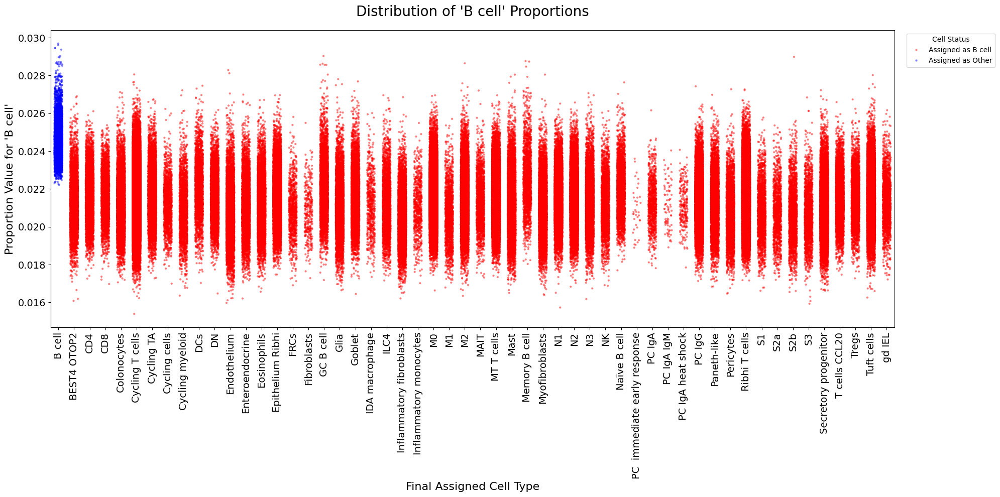

Generating detailed plot for: 'BEST4 OTOP2'


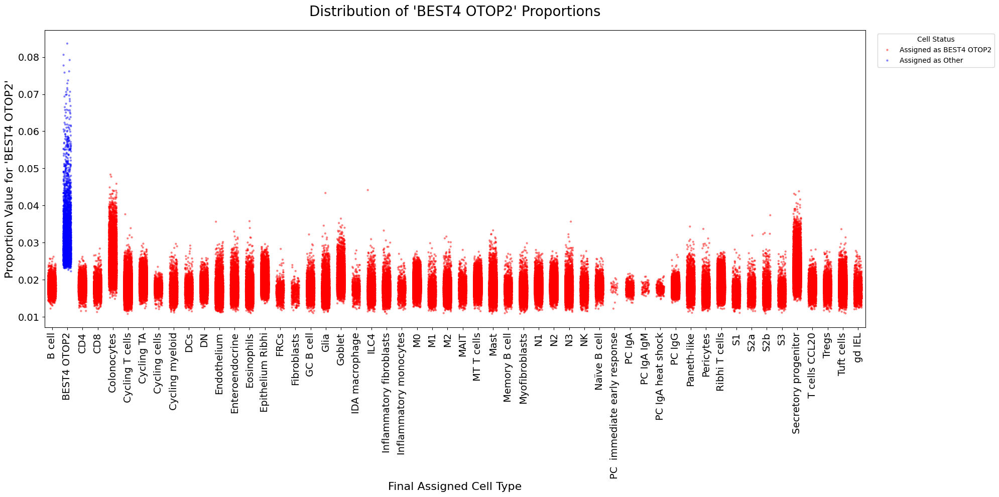

Generating detailed plot for: 'CD4'


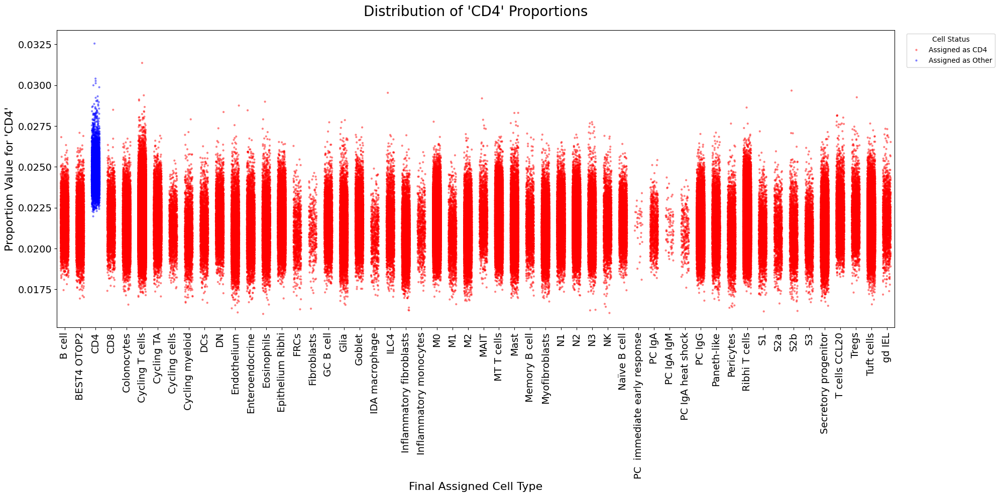

Generating detailed plot for: 'CD8'


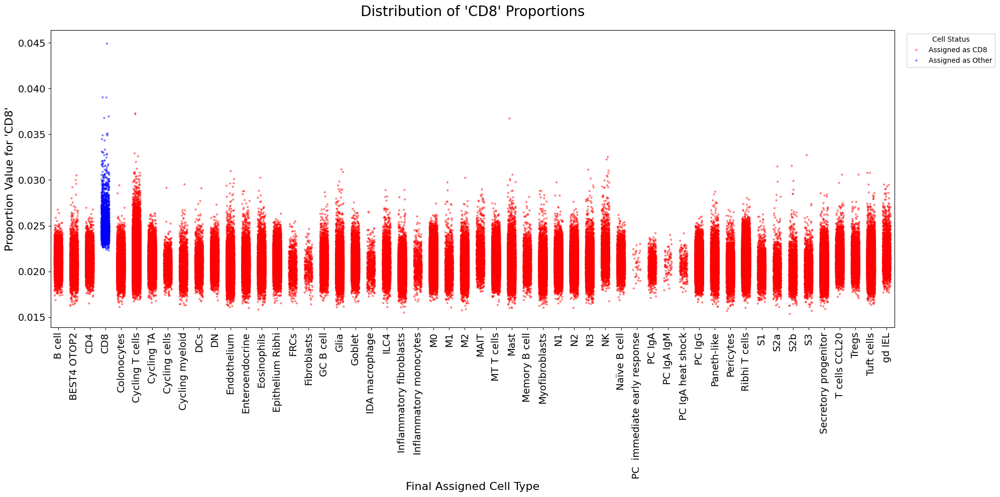

Generating detailed plot for: 'Colonocytes'


Generating detailed plot for: 'Cycling T cells'


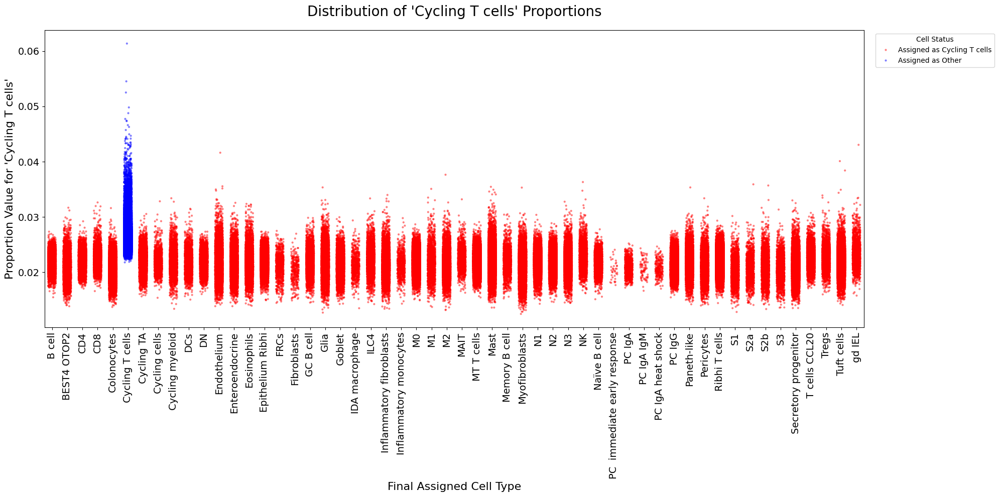

Generating detailed plot for: 'Cycling TA'


Generating detailed plot for: 'Cycling cells'


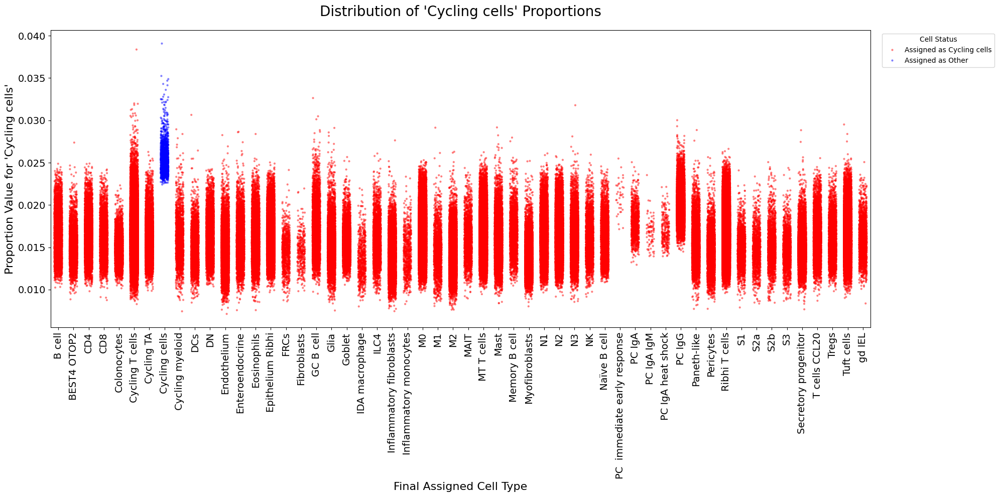

Generating detailed plot for: 'Cycling myeloid'


Generating detailed plot for: 'DCs'


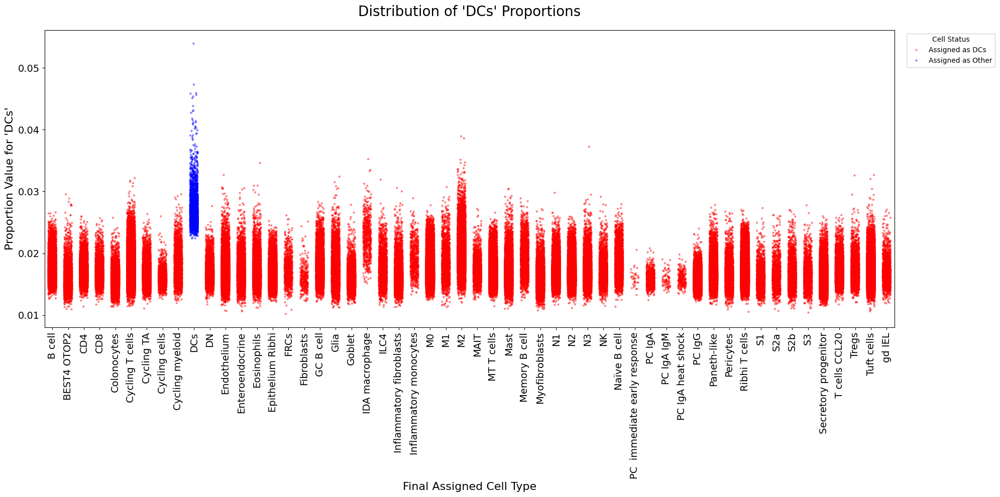

Generating detailed plot for: 'DN'


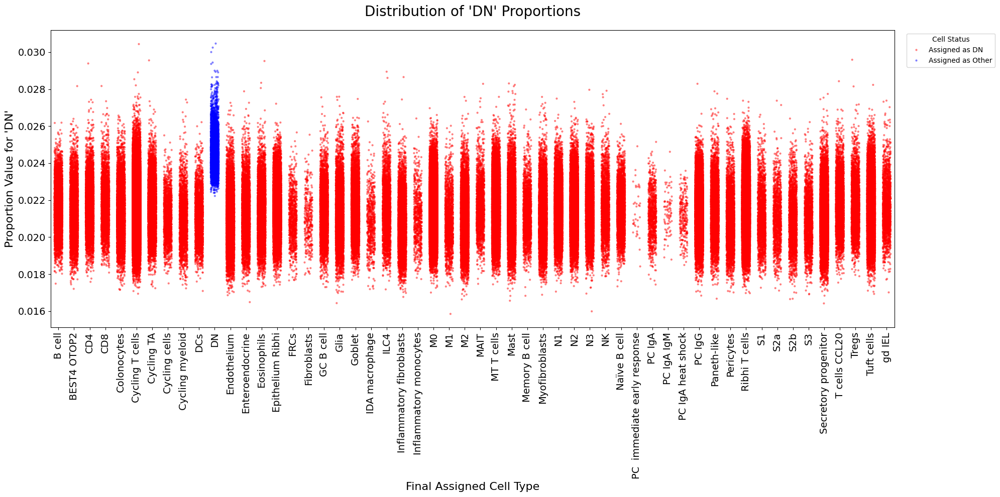

Generating detailed plot for: 'Endothelium'


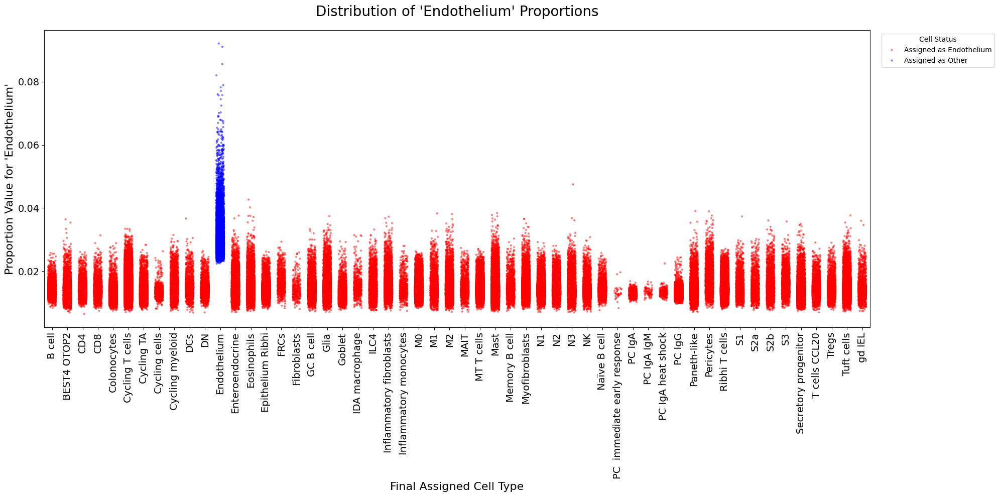

Generating detailed plot for: 'Enteroendocrine'


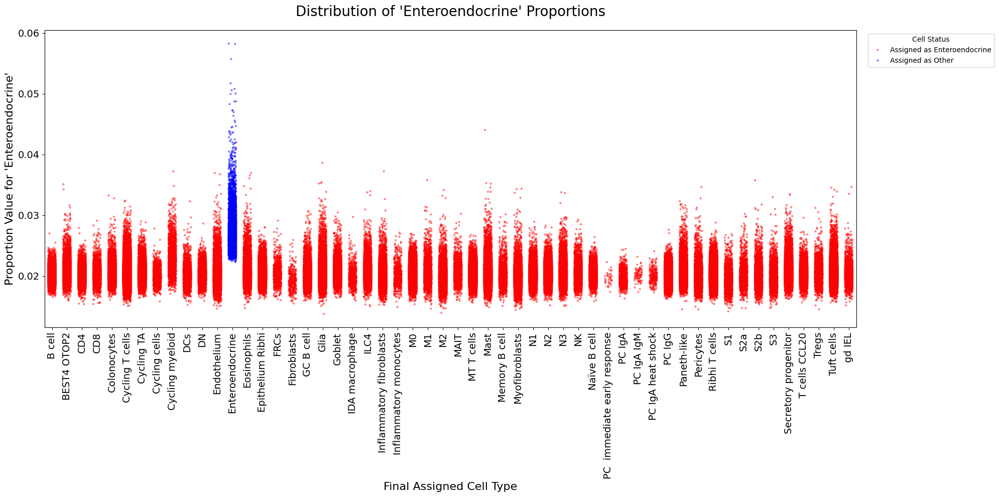

Generating detailed plot for: 'Eosinophils'


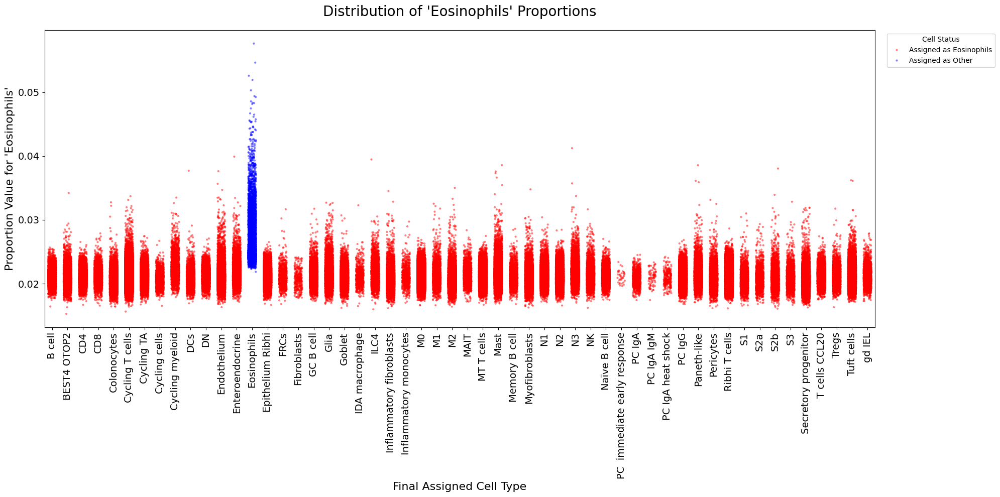

Generating detailed plot for: 'Epithelium Ribhi'


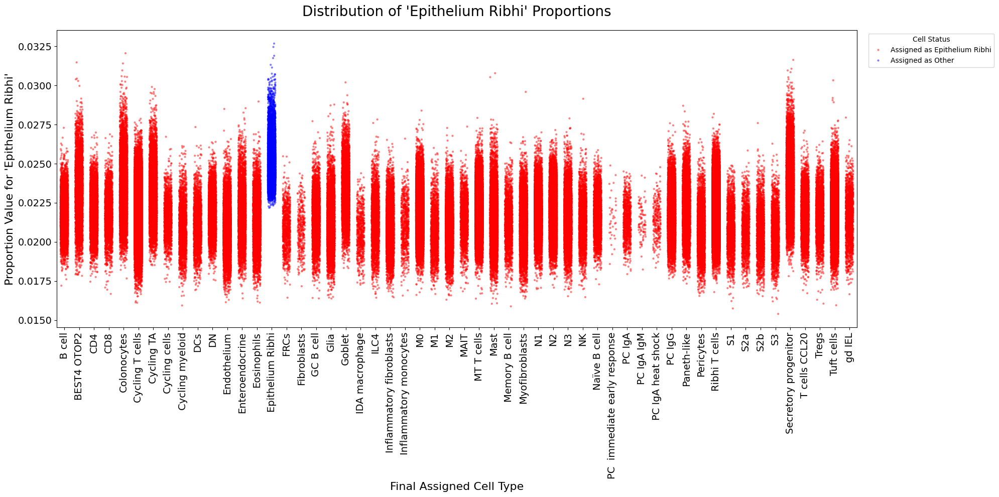

Generating detailed plot for: 'FRCs'


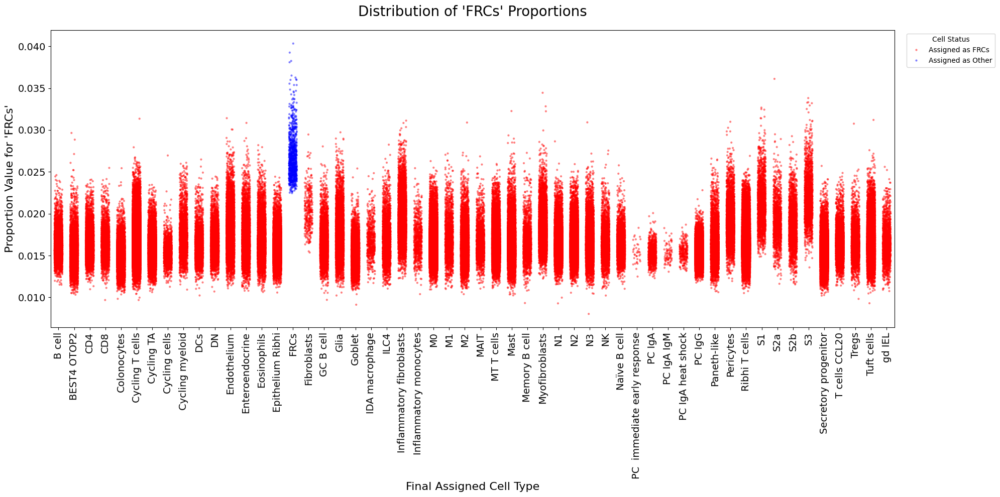

Generating detailed plot for: 'Fibroblasts'


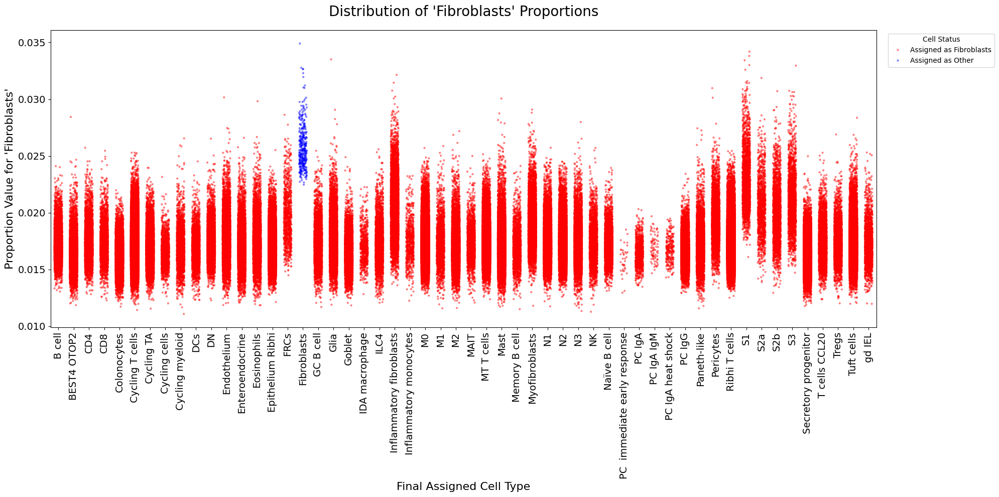

Generating detailed plot for: 'GC B cell'


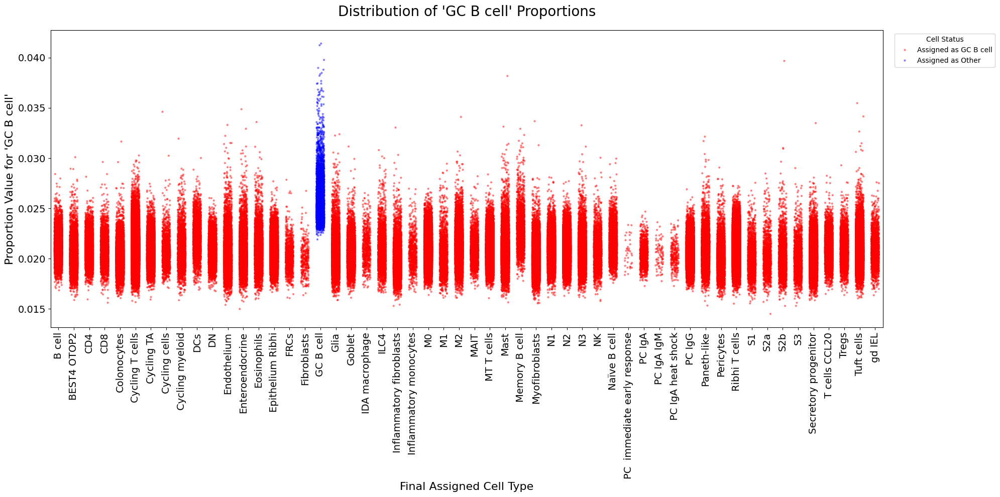

Generating detailed plot for: 'Glia'


Generating detailed plot for: 'Goblet'


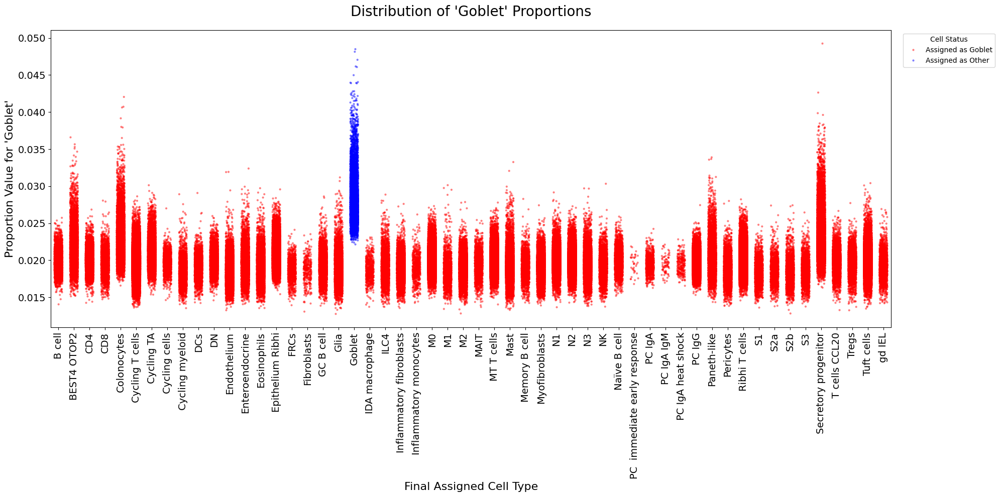

Generating detailed plot for: 'IDA macrophage'


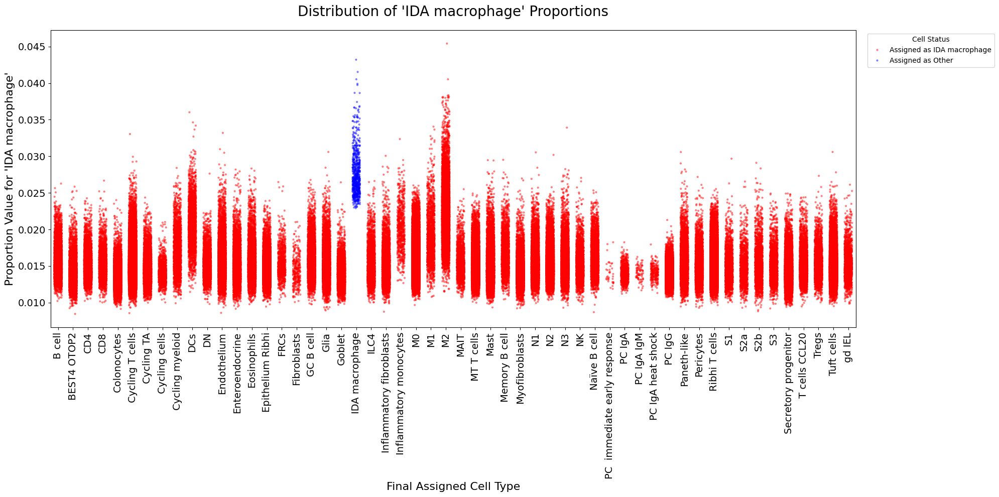

Generating detailed plot for: 'ILC4'


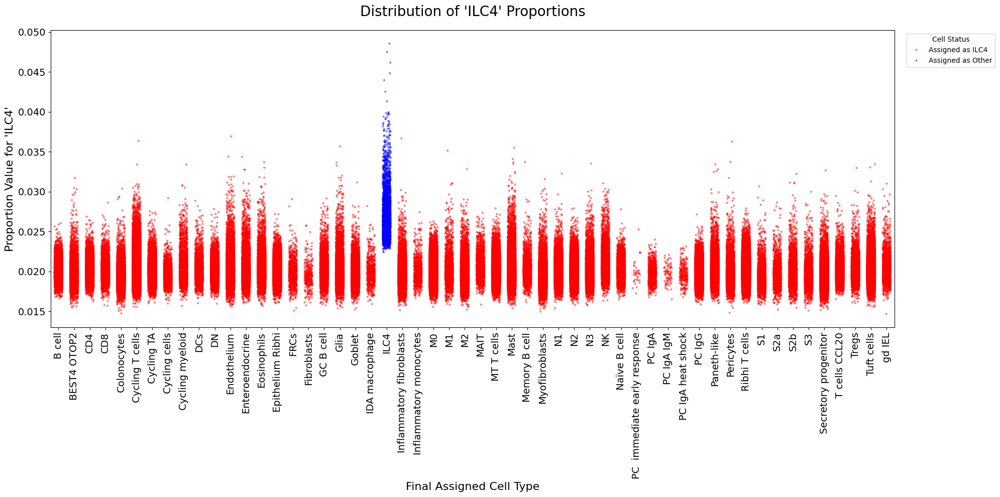

Generating detailed plot for: 'Inflammatory fibroblasts'


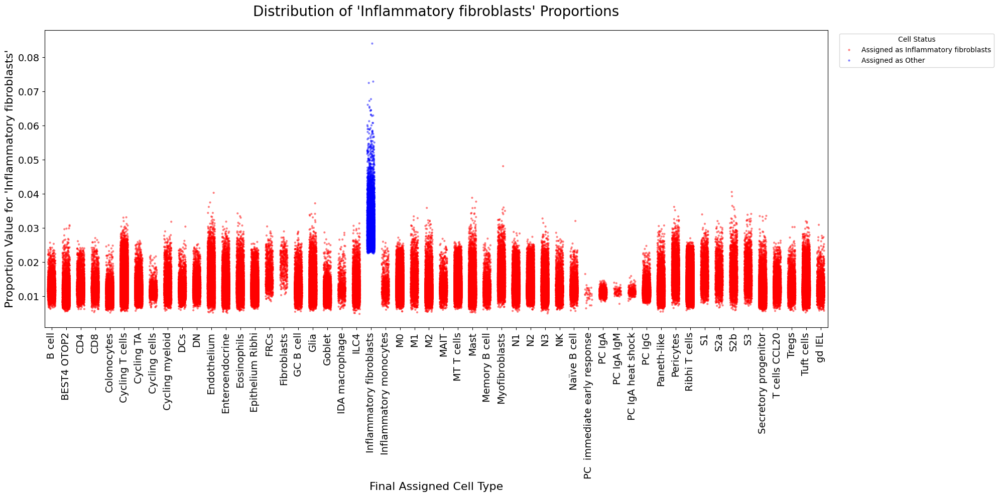

Generating detailed plot for: 'Inflammatory monocytes'


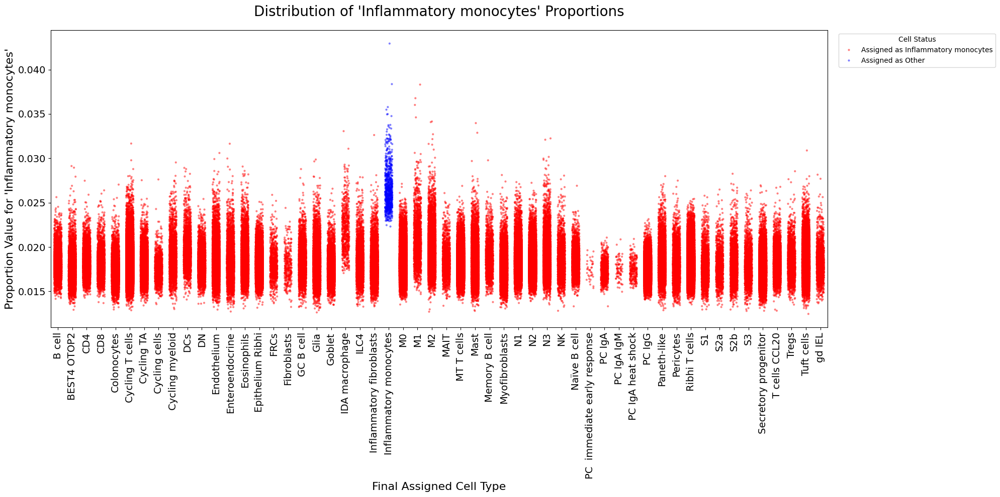

Generating detailed plot for: 'M0'


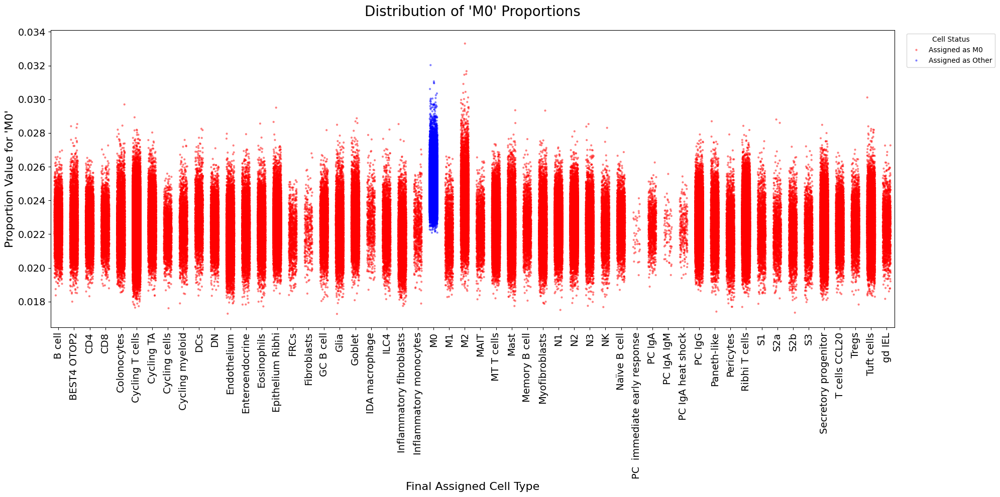

Generating detailed plot for: 'M1'


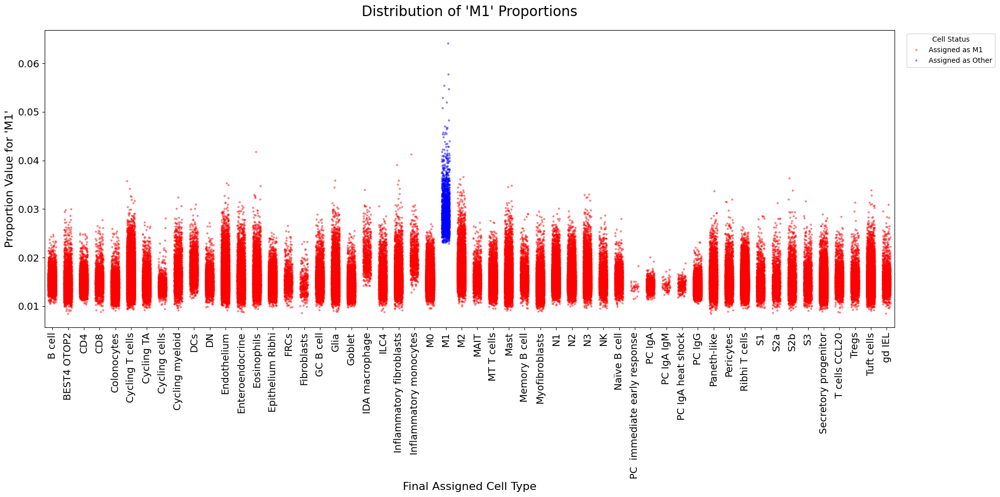

Generating detailed plot for: 'M2'


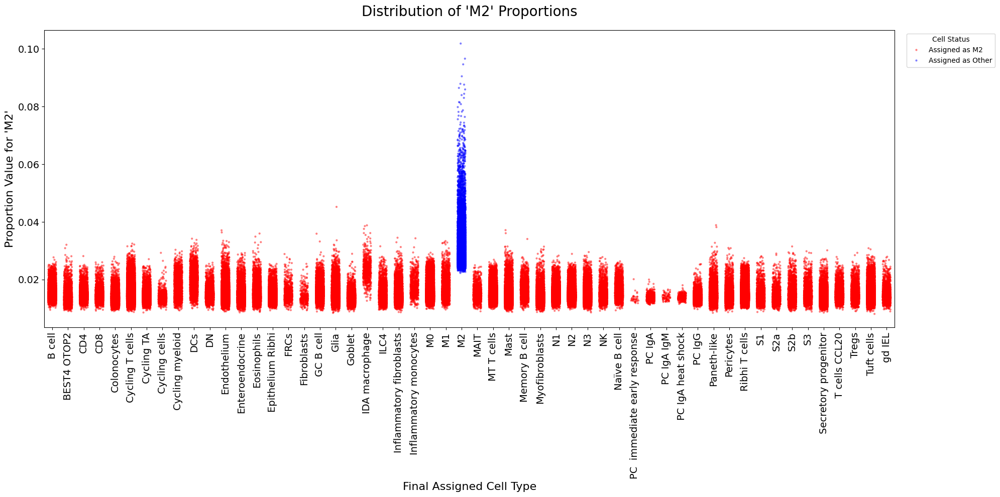

Generating detailed plot for: 'MAIT'


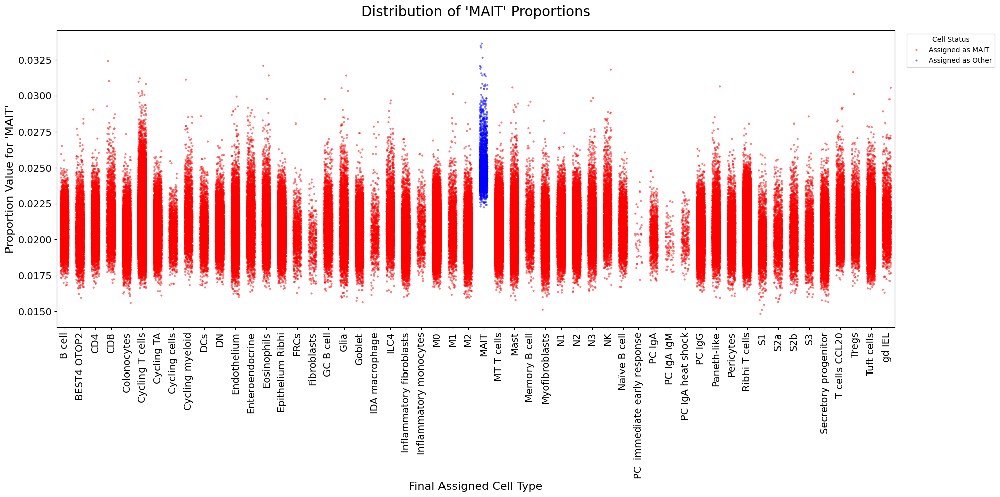

Generating detailed plot for: 'MT T cells'


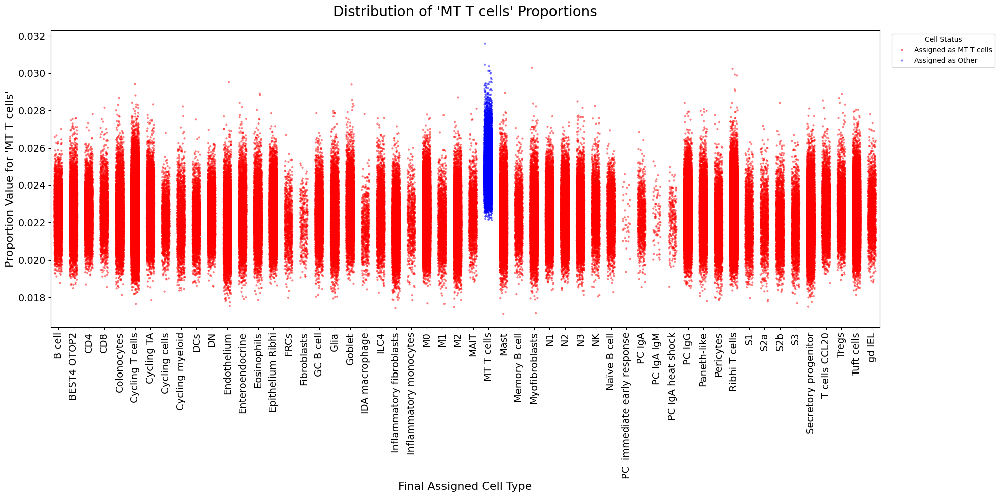

Generating detailed plot for: 'Mast'


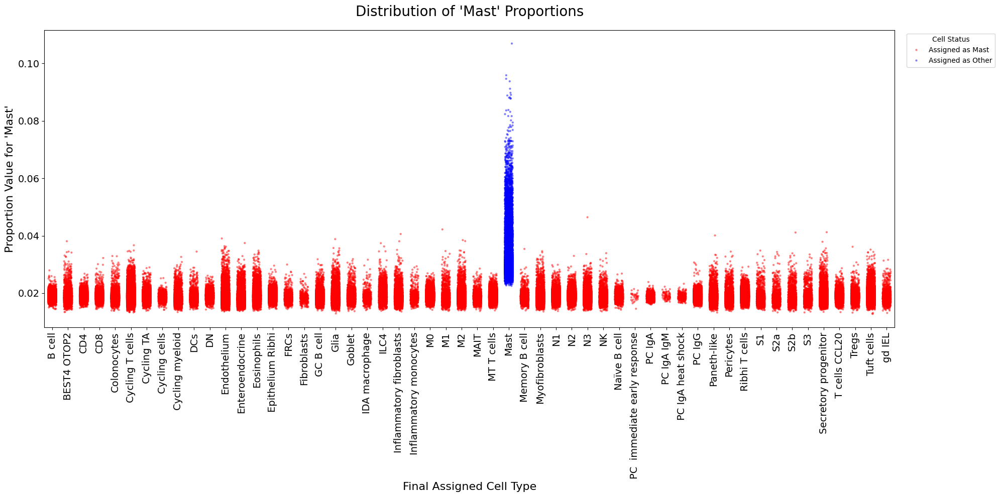

Generating detailed plot for: 'Memory B cell'


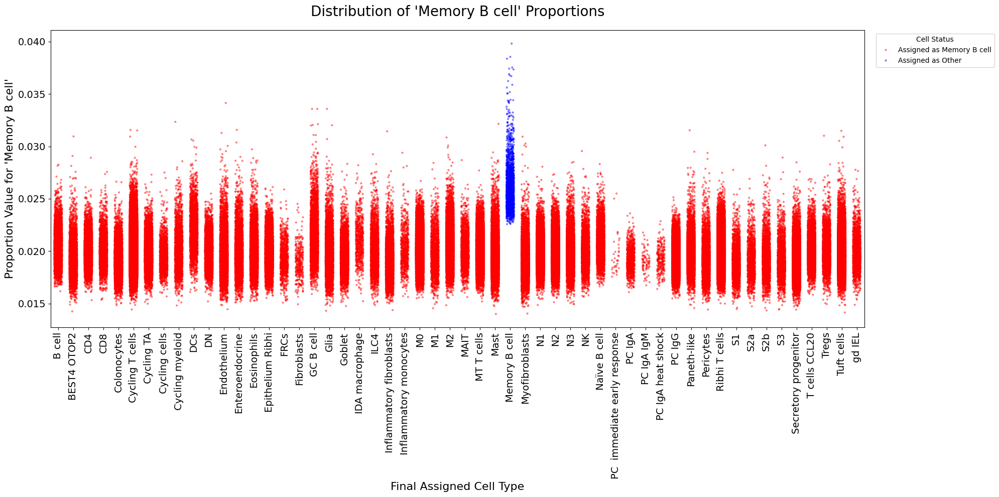

Generating detailed plot for: 'Myofibroblasts'


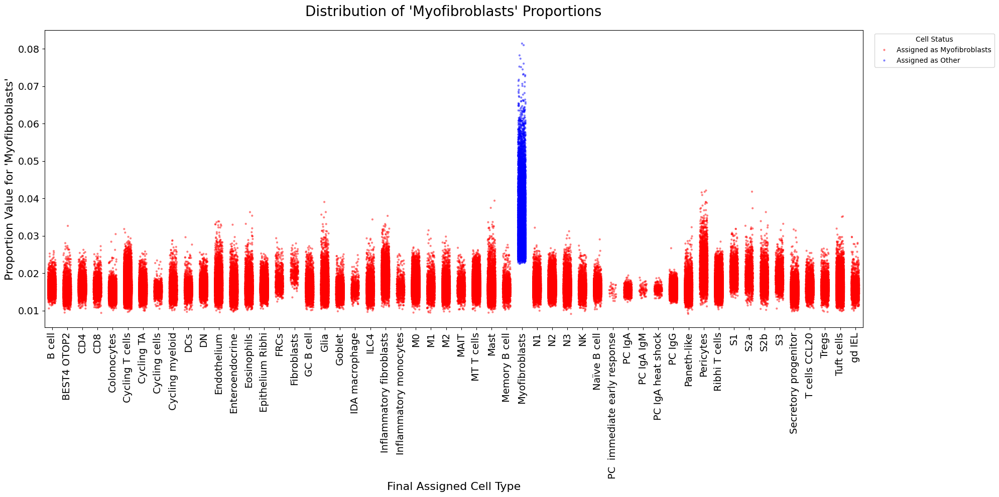

Generating detailed plot for: 'N1'


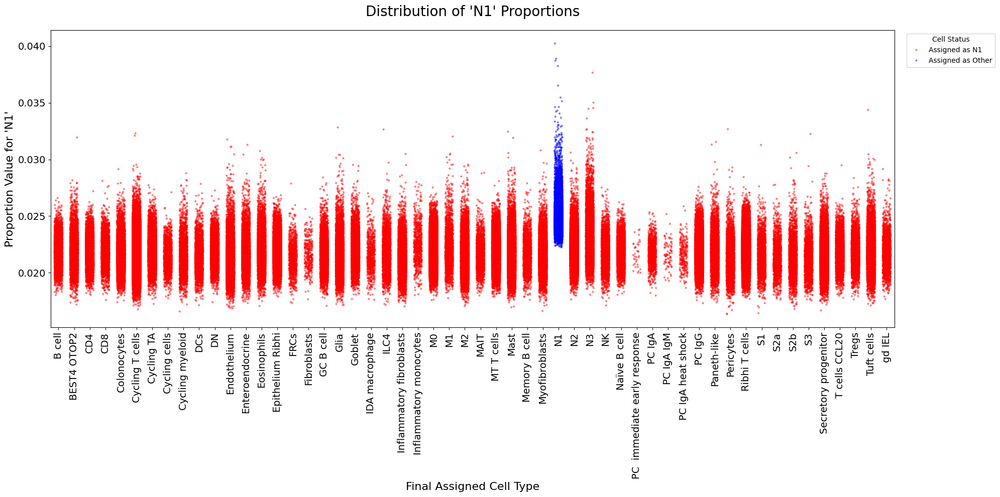

Generating detailed plot for: 'N2'


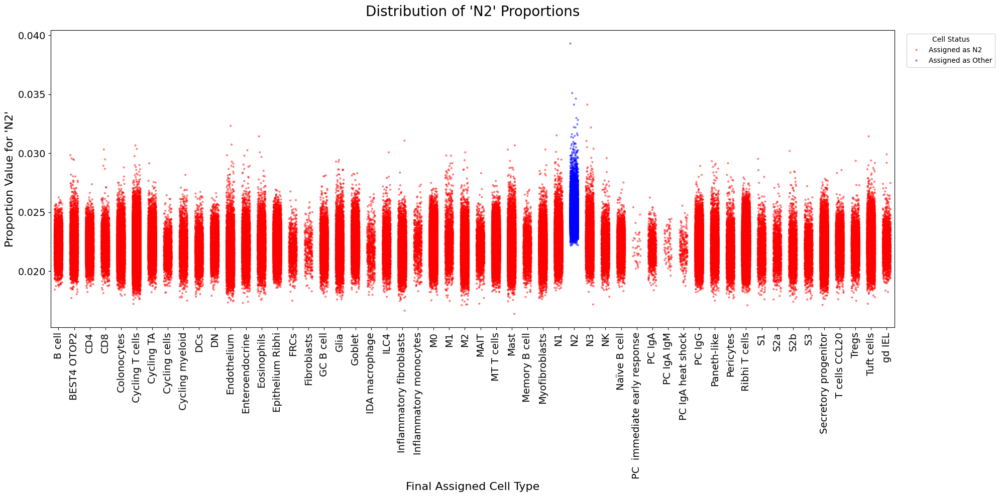

Generating detailed plot for: 'N3'


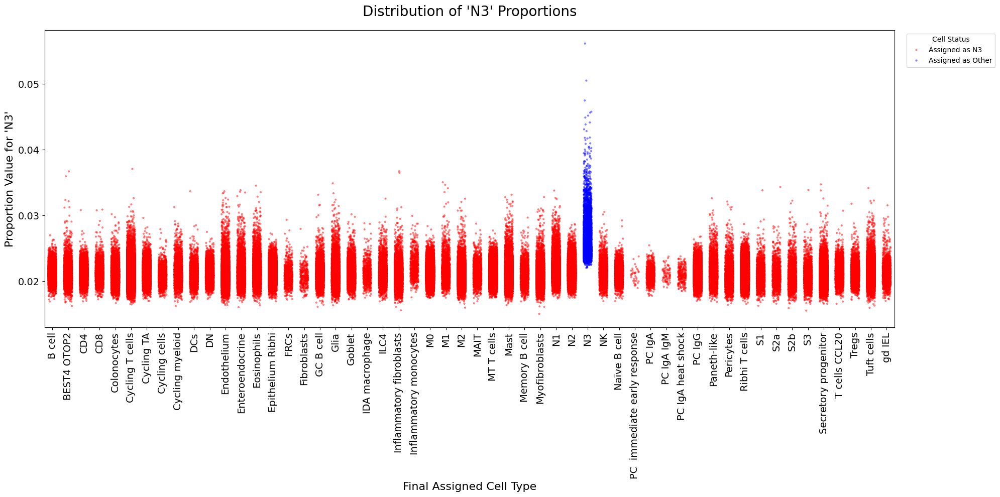

Generating detailed plot for: 'NK'


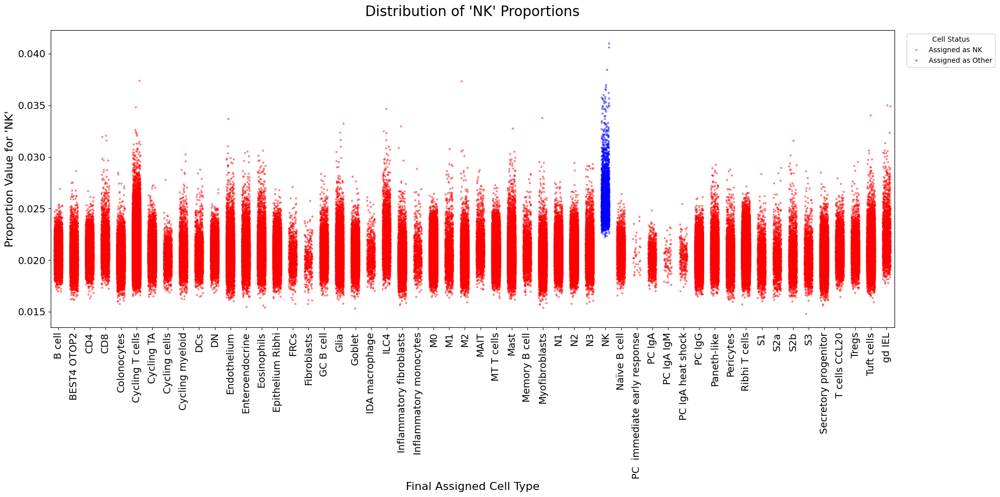

Generating detailed plot for: 'Naïve B cell'


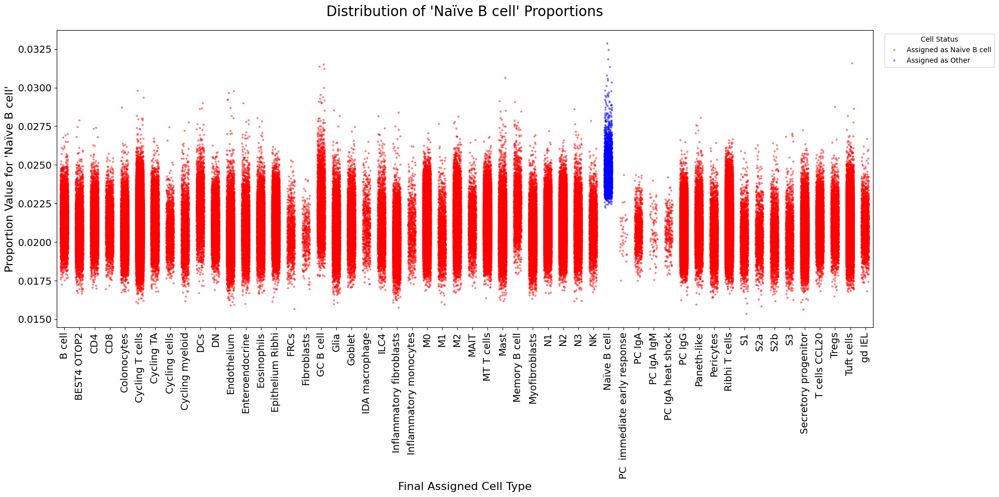

Generating detailed plot for: 'PC  immediate early response'


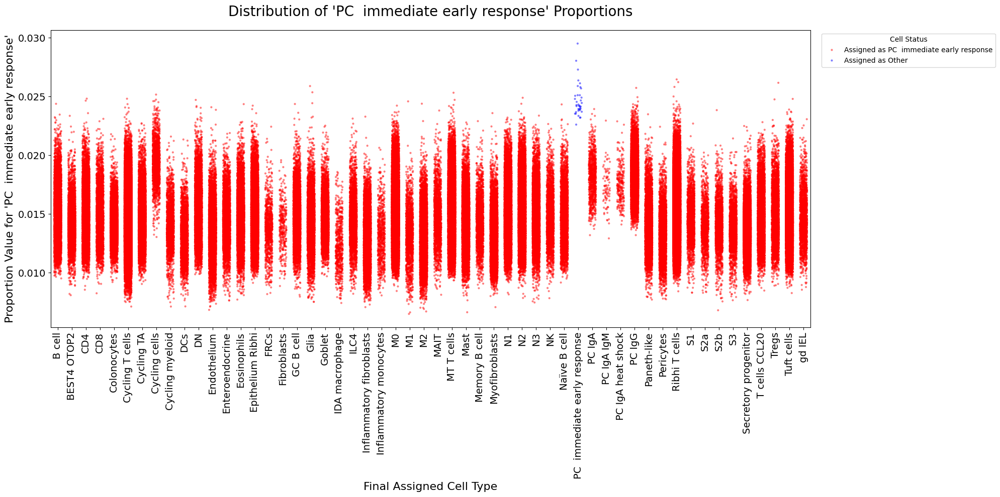

Generating detailed plot for: 'PC IgA'


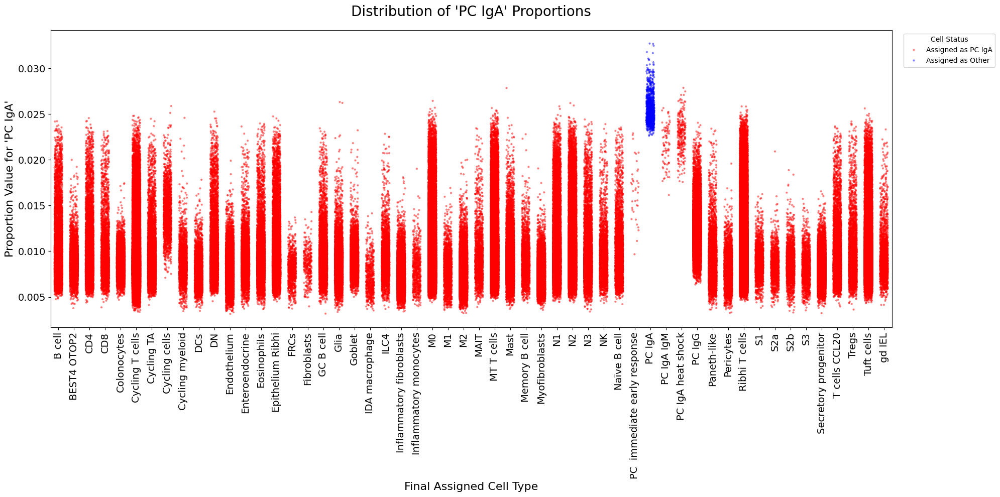

Generating detailed plot for: 'PC IgA IgM'


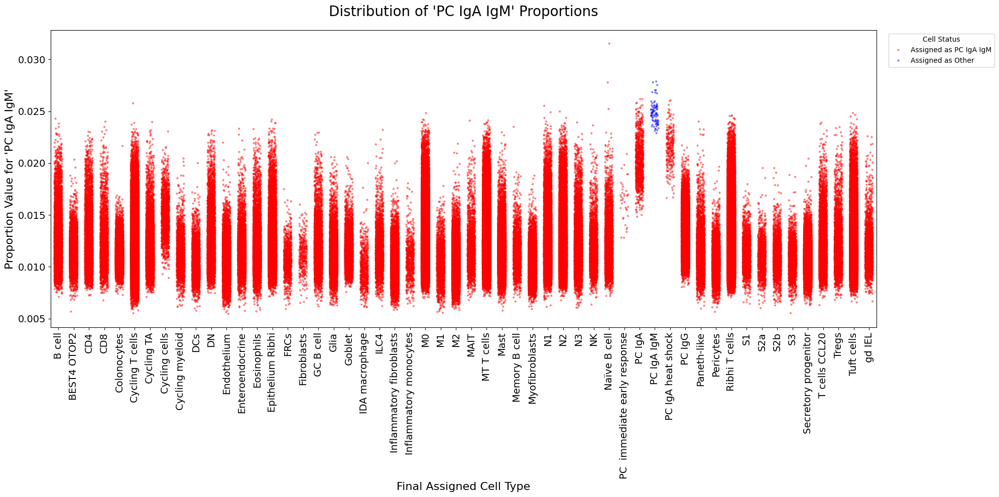

Generating detailed plot for: 'PC IgA heat shock'


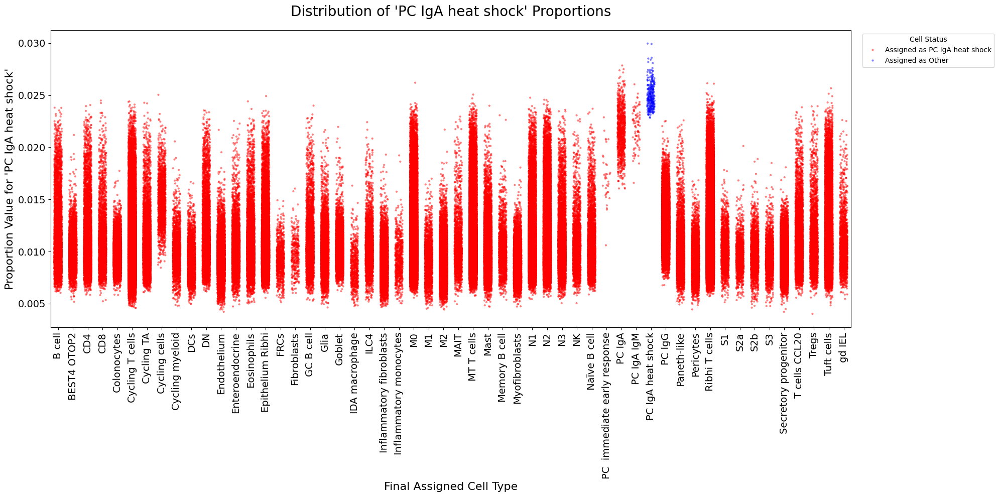

Generating detailed plot for: 'PC IgG'


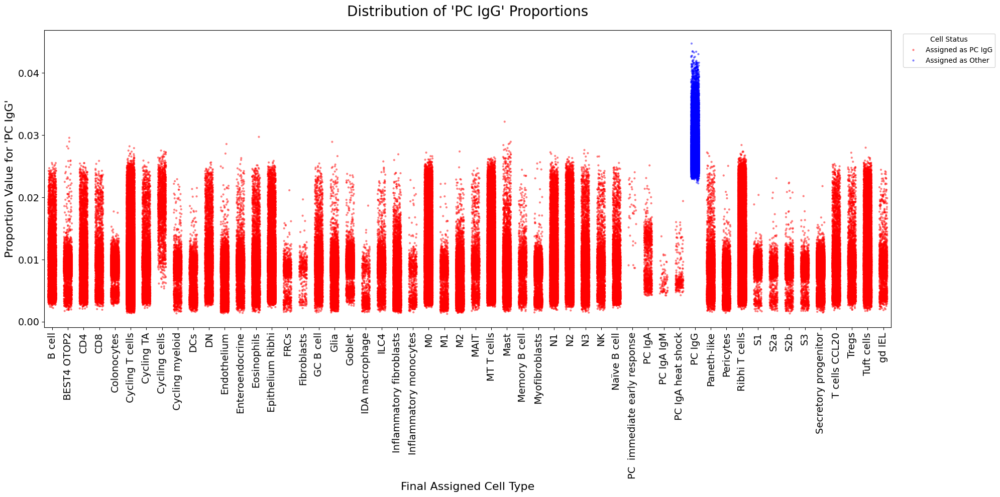

Generating detailed plot for: 'Paneth-like'


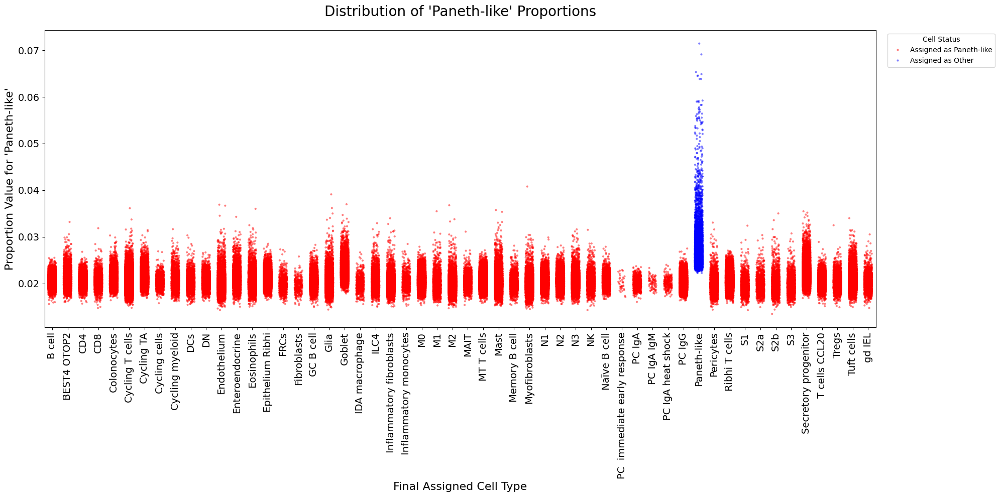

Generating detailed plot for: 'Pericytes'


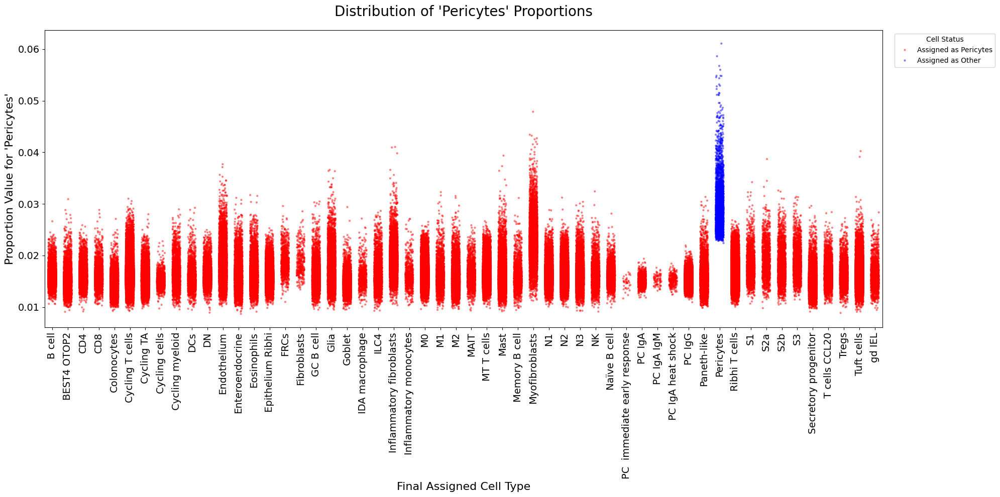

Generating detailed plot for: 'Ribhi T cells'


Generating detailed plot for: 'S1'


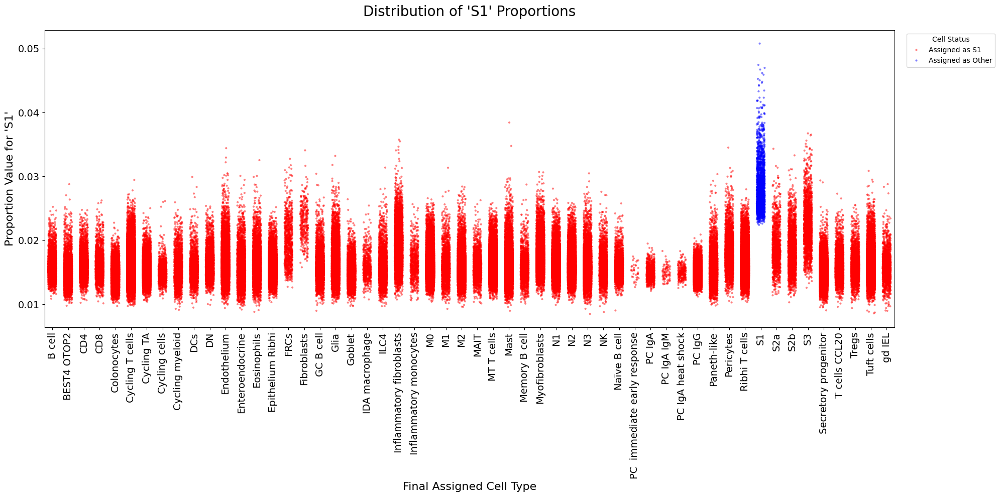

Generating detailed plot for: 'S2a'


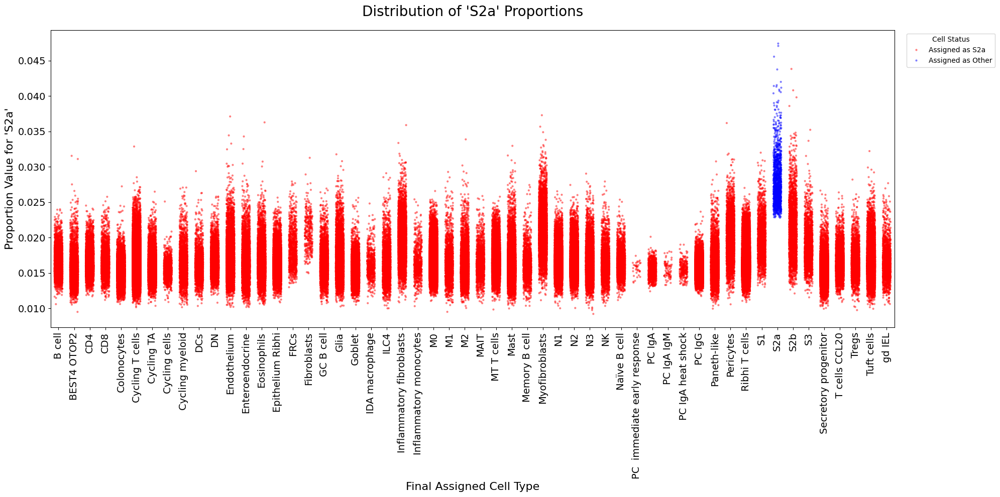

Generating detailed plot for: 'S2b'


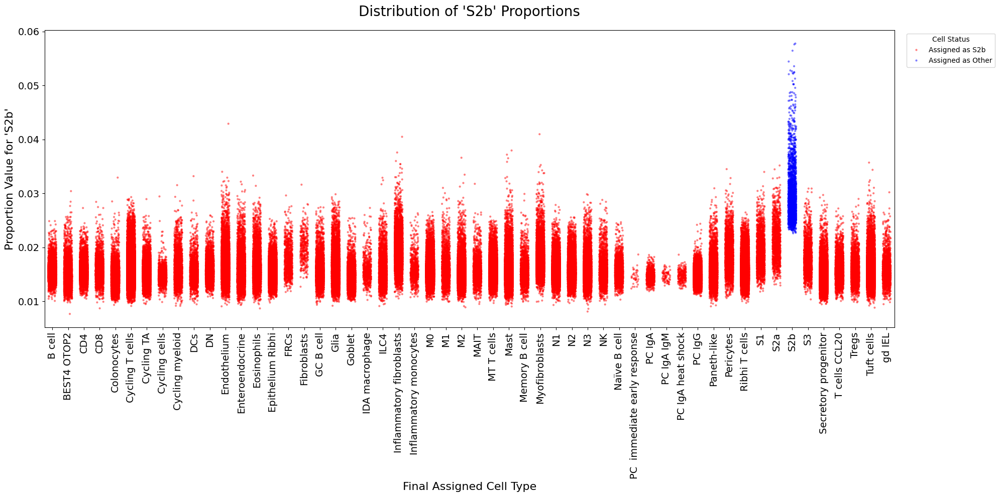

Generating detailed plot for: 'S3'


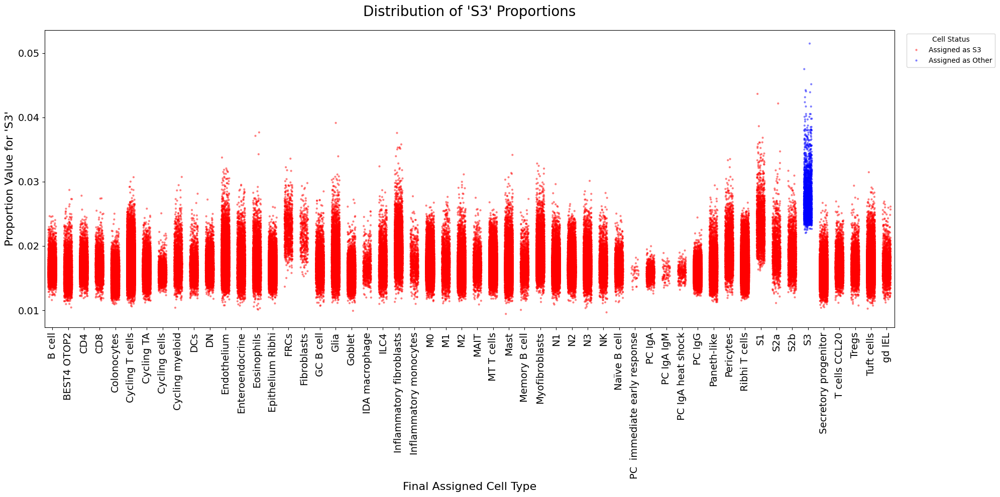

Generating detailed plot for: 'Secretory progenitor'


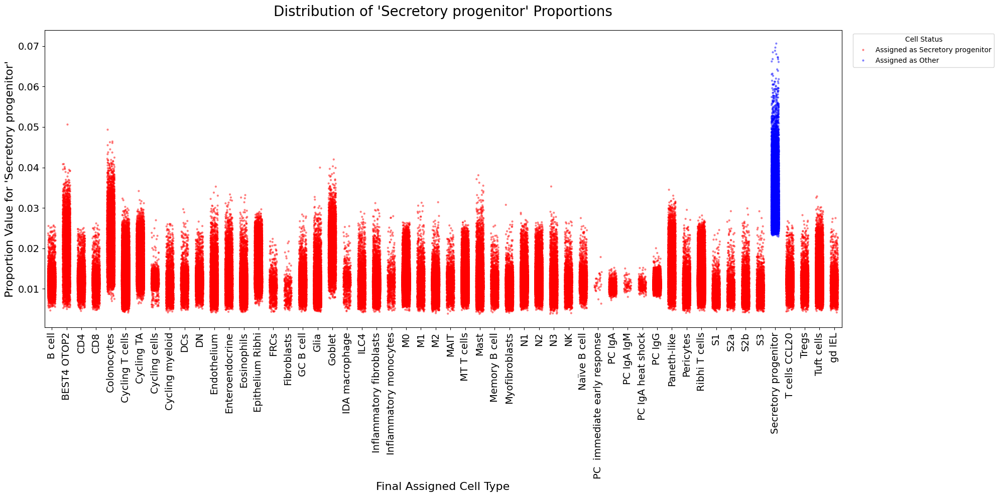

Generating detailed plot for: 'T cells CCL20'


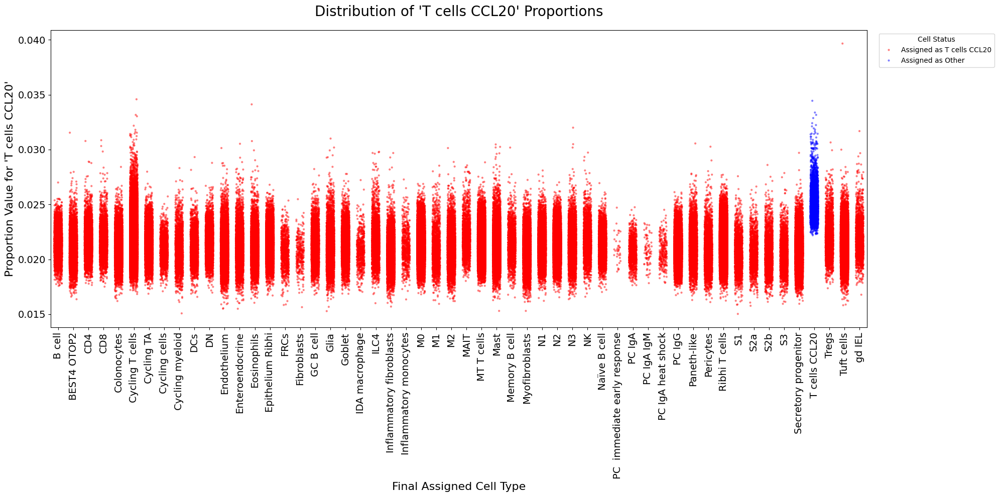

Generating detailed plot for: 'Tregs'


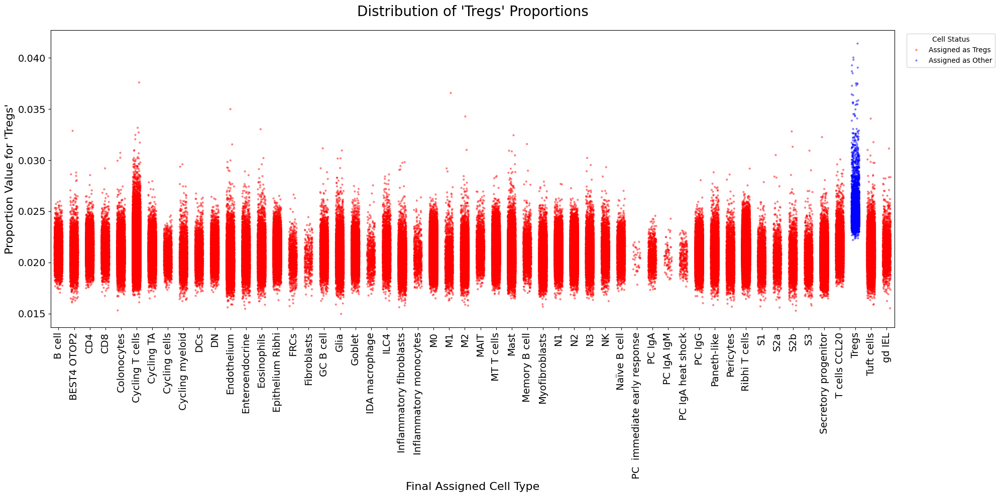

Generating detailed plot for: 'Tuft cells'


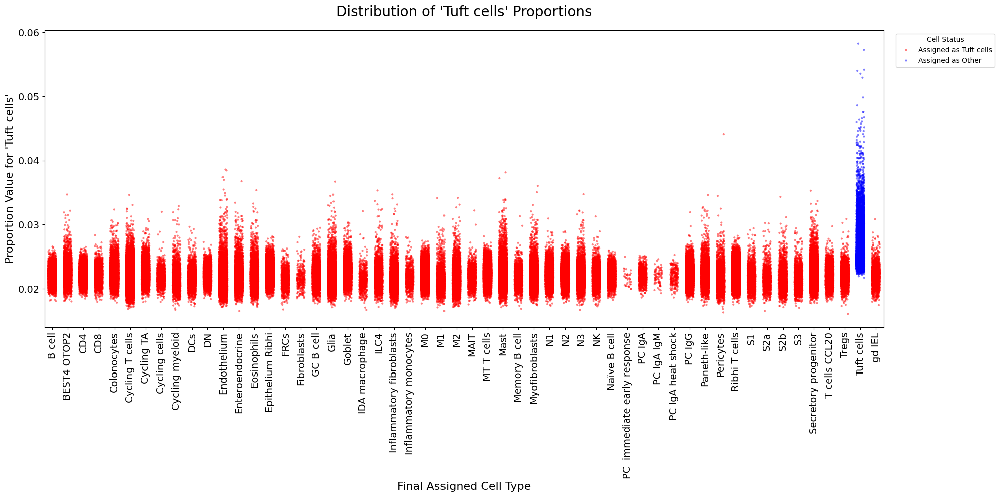

Generating detailed plot for: 'gd IEL'



--- Analysis Complete ---


In [16]:
# --- 1. Load the Proportions Data ---
# Define the path to your proportions file
proportions_path = "/blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances_proportions.csv"

try:
    # Read the data, assuming the first column is the cell ID
    df_props = pd.read_csv(proportions_path, index_col=0)
    print(f"Successfully loaded data from: {proportions_path}")

    # --- 2. Determine the Assigned Cell Type for Each Cell ---
    # For each row, find the column name with the maximum value (proportion).
    # This becomes our 'assigned_type' column.
    df_props['assigned_type'] = df_props.idxmax(axis=1)
    
    print("\n'assigned_type' column generated successfully.")
    # print(df_props['assigned_type'].value_counts()) # Optional: See the counts of each assigned type

    # --- 3. Visualize the Results (One Plot Per Cell Type) ---
    unique_assigned_types = sorted(df_props['assigned_type'].unique())
    print(f"\nFound {len(unique_assigned_types)} unique cell types. Generating one detailed plot for each...")

    output_dir = os.path.dirname(proportions_path) # Get directory to save plots

    for cell_type_to_plot in unique_assigned_types:
        print(f"Generating detailed plot for: '{cell_type_to_plot}'")

        # Create a temporary column to highlight the target cell type's data points
        df_props['is_match'] = (df_props['assigned_type'] == cell_type_to_plot)

        # Create a wide figure to accommodate all x-axis labels
        plt.figure(figsize=(20, 10))
        ax = plt.gca()

        # Use seaborn's stripplot for visualization
        sns.stripplot(
            data=df_props,
            x='assigned_type',      # The x-axis shows the final assigned type
            y=cell_type_to_plot,    # The y-axis shows the proportion value for the type being plotted
            hue='is_match',         # Color points based on whether they match the target type
            palette={True: 'blue', False: 'red'}, # Use a different color for non-matches
            jitter=0.25,
            order=unique_assigned_types, # Ensures consistent x-axis order
            size=3,
            alpha=0.5,
            ax=ax
        )

        # --- Improve the plot labels and title ---
        ax.set_title(f"Distribution of '{cell_type_to_plot}' Proportions", fontsize=20, pad=20)
        ax.set_ylabel(f"Proportion Value for '{cell_type_to_plot}'", fontsize=16)
        ax.set_xlabel("Final Assigned Cell Type", fontsize=16)
        plt.xticks(rotation=90) # Rotate labels for readability
        ax.tick_params(axis='both', which='major', labelsize=14)

        # --- Customize the legend ---
        handles, labels = ax.get_legend_handles_labels()
        if len(handles) > 1:
             new_labels = [f"Assigned as {cell_type_to_plot}", "Assigned as Other"]
             ax.legend(handles, new_labels, title="Cell Status", bbox_to_anchor=(1.01, 1), loc='upper left')
        else: # If all cells are of one type, legend is not needed
             ax.get_legend().remove()

        plt.tight_layout()

        # --- Save the figure ---
        # Sanitize filename by replacing spaces and slashes
        safe_filename = f"Proportion_distribution_{cell_type_to_plot.replace(' ', '_').replace('/', '_')}.png"
        output_filepath = os.path.join(output_dir, safe_filename)
        plt.savefig(output_filepath, dpi=150, bbox_inches='tight')
        
        plt.show() # Display the plot in the notebook

    print("\n--- Analysis Complete ---")

except FileNotFoundError:
    print(f"Error: The file was not found at the specified path.")
    print(f"Please ensure this path is correct: {proportions_path}")
except Exception as e:
    print(f"An error occurred: {e}")

In [17]:
# --- 1. File Path ---
# This now points to the proportions file you generated earlier.
path_to_proportions_csv = '/blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances_proportions.csv'

print("--- Starting Cumulative Analysis on Proportions Data ---")

# --- 2. Load the Data ---
try:
    print(f"Loading proportions from: {path_to_proportions_csv}")
    df_props = pd.read_csv(path_to_proportions_csv, index_col=0)
    print("Proportions data loaded successfully.")

except FileNotFoundError as e:
    print(f"FATAL ERROR: Could not find the file. Please check your path. Details: {e}")
    # exit() # In a notebook, this will stop the cell

# --- 3. Define the Analysis Function ---

def get_significant_types_by_cumulative_prob(row, prob_threshold=0.80):
    """
    Finds the smallest set of cell types whose cumulative proportion
    exceeds the specified threshold.
    """
    # Sort the proportions for the cell in descending order
    sorted_row = row.sort_values(ascending=False)
    
    # Calculate the cumulative sum
    cumulative_sum = sorted_row.cumsum()
    
    # Find the cell types needed to reach the threshold
    significant_types = cumulative_sum[cumulative_sum <= prob_threshold].index.tolist()
    
    # Always include at least the top type
    if not significant_types:
        return [sorted_row.index[0]]
    else:
        # Also include the first type that pushes the sum *over* the threshold
        next_type_index = len(significant_types)
        if next_type_index < len(sorted_row):
            significant_types.append(sorted_row.index[next_type_index])
        return significant_types

# --- 4. Run the Analysis ---

# Defines the cutoff. 0.8 means "find the fewest types that account for 80% of the signal".
CUMULATIVE_PROB_THRESHOLD = 0.80

print(f"\nApplying cumulative proportion cutoff with a threshold of {CUMULATIVE_PROB_THRESHOLD*100}%...")

# Apply the function to each row (cell)
significant_sets = df_props.apply(
    get_significant_types_by_cumulative_prob,
    axis=1,
    prob_threshold=CUMULATIVE_PROB_THRESHOLD
)

# Add the results to new columns
df_props['significant_types_cumulative'] = significant_sets
df_props['num_significant_cumulative'] = df_props['significant_types_cumulative'].apply(len)


# --- 5. Display Results ---
print("\n--- Results: Cumulative Significant Cell Type Sets per Cell ---")
print(df_props[['num_significant_cumulative', 'significant_types_cumulative']].head(15))

print("\n--- Summary: Number of Significant Types per Cell ---")
print(df_props['num_significant_cumulative'].value_counts().sort_index())


# --- 6. Save the Results to a File ---
output_dir = os.path.dirname(path_to_proportions_csv)
output_filename = 'proportions_analysis_cumulative_sets.csv'
output_path = os.path.join(output_dir, output_filename)

try:
    df_props.to_csv(output_path)
    print(f"\nAnalysis complete. Full results saved to: {output_path}")
except Exception as e:
    print(f"\nError saving file: {e}")

--- Starting Cumulative Analysis on Proportions Data ---
Loading proportions from: /blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances_proportions.csv
Proportions data loaded successfully.

Applying cumulative proportion cutoff with a threshold of 80.0%...

--- Results: Cumulative Significant Cell Type Sets per Cell ---
                num_significant_cumulative  \
unique_cell_id                               
CD c_1_1                                39   
CD c_1_2                                39   
CD c_1_3                                40   
CD c_1_4                                39   
CD c_1_5                                40   
CD c_1_6                                39   
CD c_1_7                                39   
CD c_1_8                                39   
CD c_1_10                               40   
CD c_1_11                               39   
CD c_1_12                               39   
CD c_1_14              

--- Generating Enhanced Histogram for Cumulative Analysis Results ---
Loading data from: /blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/proportions_analysis_cumulative_sets.csv

Generating histogram...


/scratch/local/9433240/ipykernel_1997198/132075126.py:32: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(



Histogram with counts and percentages saved to: /blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/cumulative_significant_histogram.png


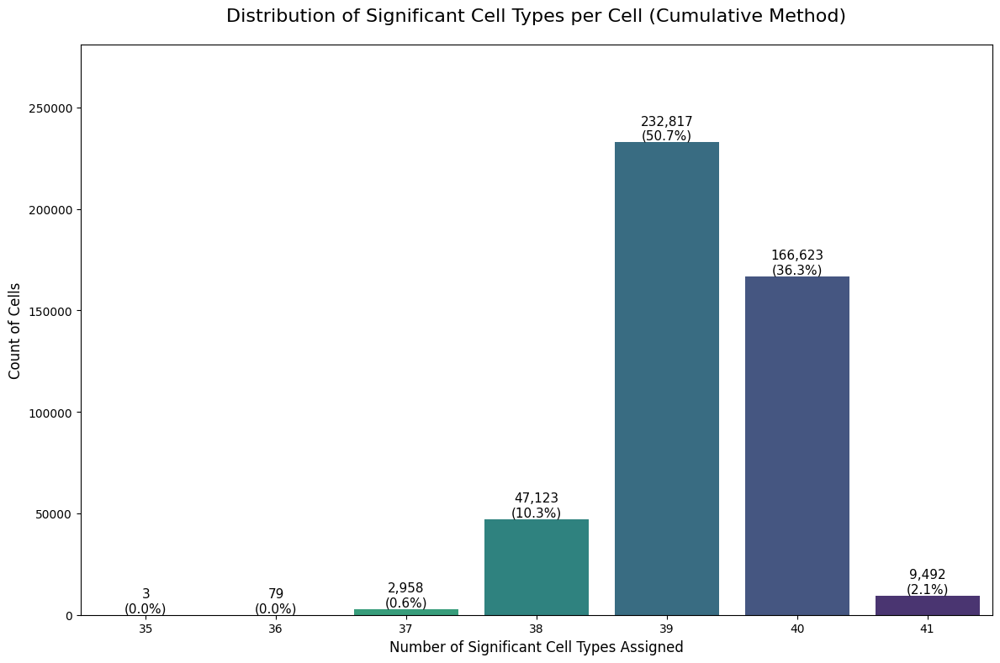

In [18]:
# --- 1. Define File Path ---
# This path points to the output from the CUMULATIVE analysis script.
path_to_results_csv = '/blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/proportions_analysis_cumulative_sets.csv'


# --- 2. Main Plotting Function ---
def plot_cumulative_histogram():
    """
    Loads the pre-analyzed cumulative data and plots the
    'num_significant_cumulative' column with counts and percentages.
    """
    print("--- Generating Enhanced Histogram for Cumulative Analysis Results ---")

    # --- Step A: Load the Data ---
    try:
        print(f"Loading data from: {path_to_results_csv}")
        df = pd.read_csv(path_to_results_csv)
    except FileNotFoundError:
        print(f"\nFATAL ERROR: The file was not found at '{path_to_results_csv}'")
        return

    # --- Step B: Verify the Column Exists ---
    # KEY CHANGE: Check for the column from the cumulative analysis.
    column_to_plot = 'num_significant_cumulative'
    if column_to_plot not in df.columns:
        print(f"\nFATAL ERROR: The required column '{column_to_plot}' was not found in the CSV file.")
        return

    # --- Step C: Generate and Save the Histogram ---
    print("\nGenerating histogram...")
    plt.figure(figsize=(12, 8))
    ax = sns.countplot(
        data=df,
        x=column_to_plot, # KEY CHANGE: Plotting the cumulative results column.
        palette='viridis_r' # Changed palette for visual distinction
    )

    # --- Improve the plot ---
    ax.set_title('Distribution of Significant Cell Types per Cell (Cumulative Method)', fontsize=16, pad=20)
    ax.set_xlabel('Number of Significant Cell Types Assigned', fontsize=12)
    ax.set_ylabel('Count of Cells', fontsize=12)

    # Add both raw count and percentage labels to each bar
    total_cells = len(df)
    for p in ax.patches:
        count = p.get_height()
        if count > 0:
            percent = 100 * count / total_cells
            label = f'{int(count):,}\n({percent:.1f}%)'
            ax.annotate(label,
                        (p.get_x() + p.get_width() / 2., count),
                        ha='center', va='center',
                        xytext=(0, 12),
                        textcoords='offset points',
                        fontsize=11)

    # Adjust plot limits to make space for labels above bars
    ax.set_ylim(top=ax.get_ylim()[1] * 1.15)
    plt.tight_layout()

    # --- Step D: Save the Figure ---
    output_dir = os.path.dirname(path_to_results_csv)
    output_filename = 'cumulative_significant_histogram.png'
    output_path = os.path.join(output_dir, output_filename)
    
    plt.savefig(output_path, dpi=150)
    print(f"\nHistogram with counts and percentages saved to: {output_path}")

    plt.show()

# --- 3. Run the plotting process ---
plot_cumulative_histogram()

--- Part 1: Loading Data and Preparing for Analysis ---
Successfully loaded proportions data from: /blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances_proportions.csv
Determining assigned cell type for each cell...
Calculating the top-1 proportion score (confidence) for each cell...
Preparation complete.

--- Part 2: Generating Histograms of Assignment Confidence ---
Generating confidence histogram for: 'B cell'


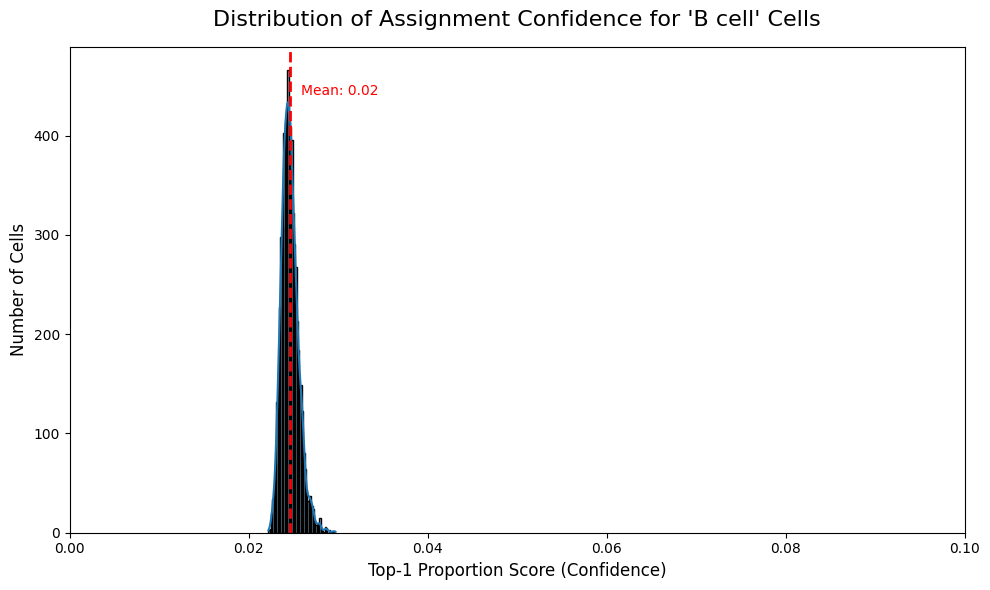

Generating confidence histogram for: 'BEST4 OTOP2'


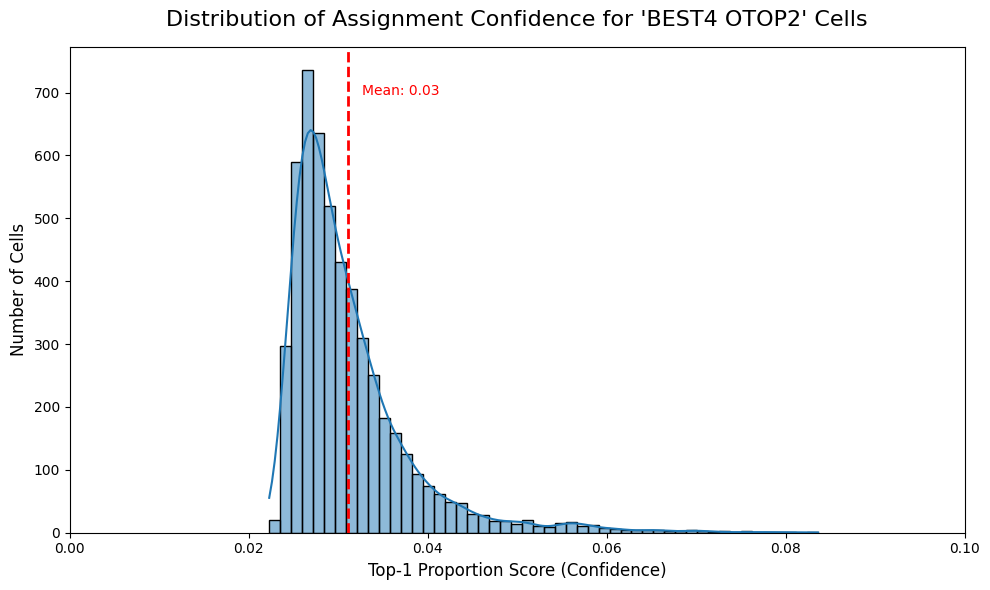

Generating confidence histogram for: 'CD4'


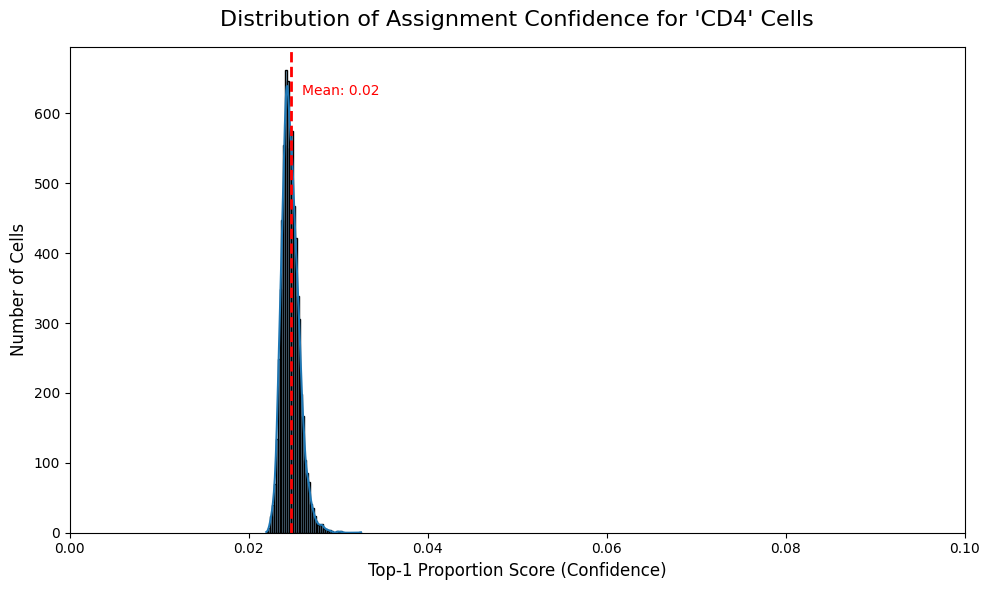

Generating confidence histogram for: 'CD8'


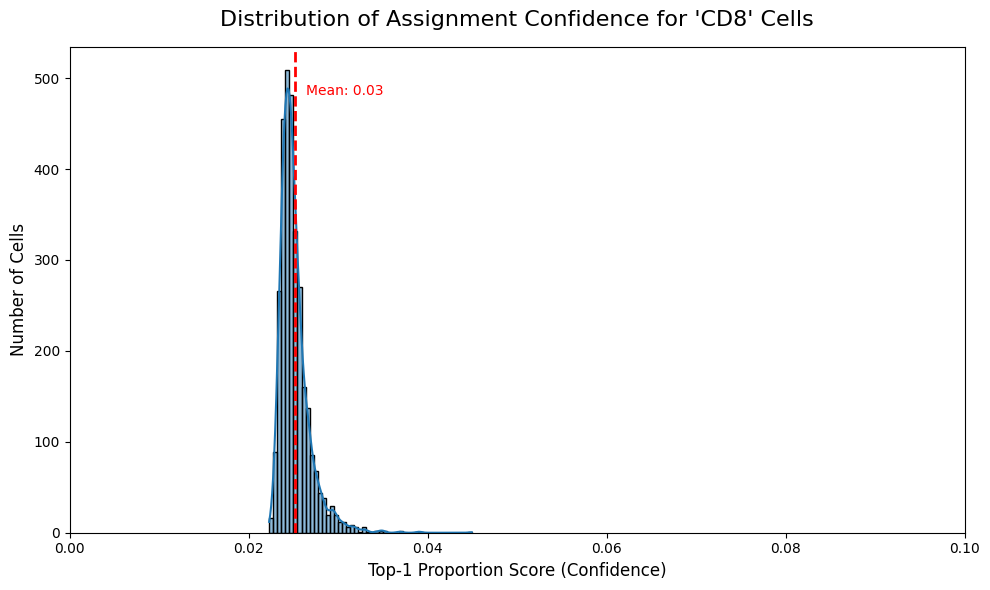

Generating confidence histogram for: 'Colonocytes'


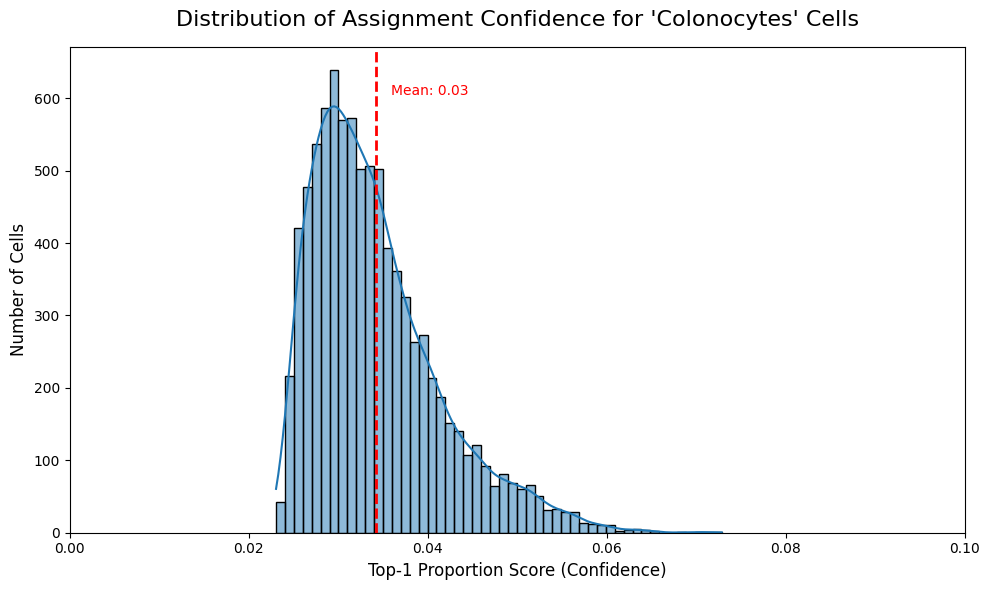

Generating confidence histogram for: 'Cycling T cells'


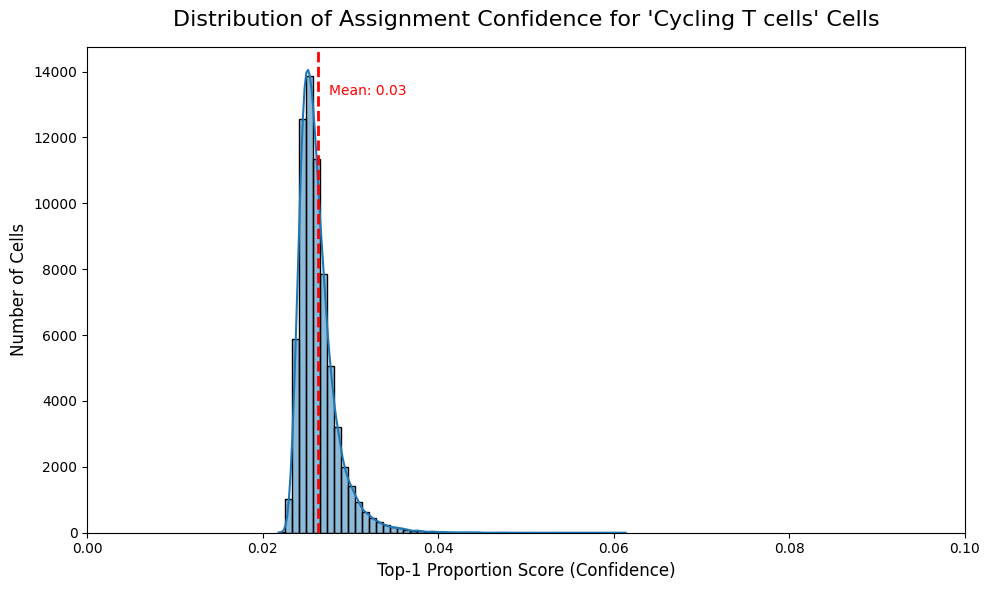

Generating confidence histogram for: 'Cycling TA'


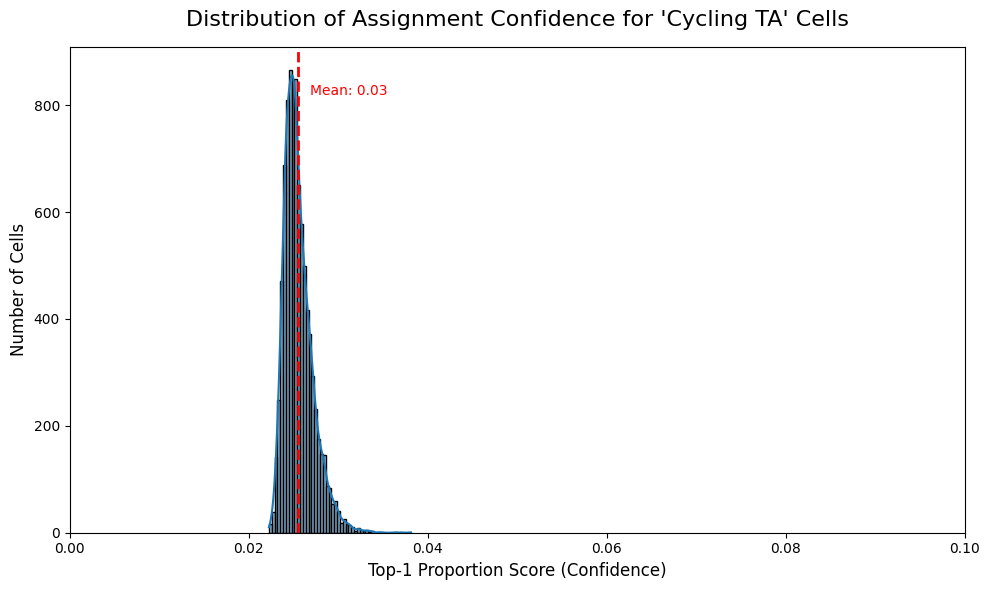

Generating confidence histogram for: 'Cycling cells'


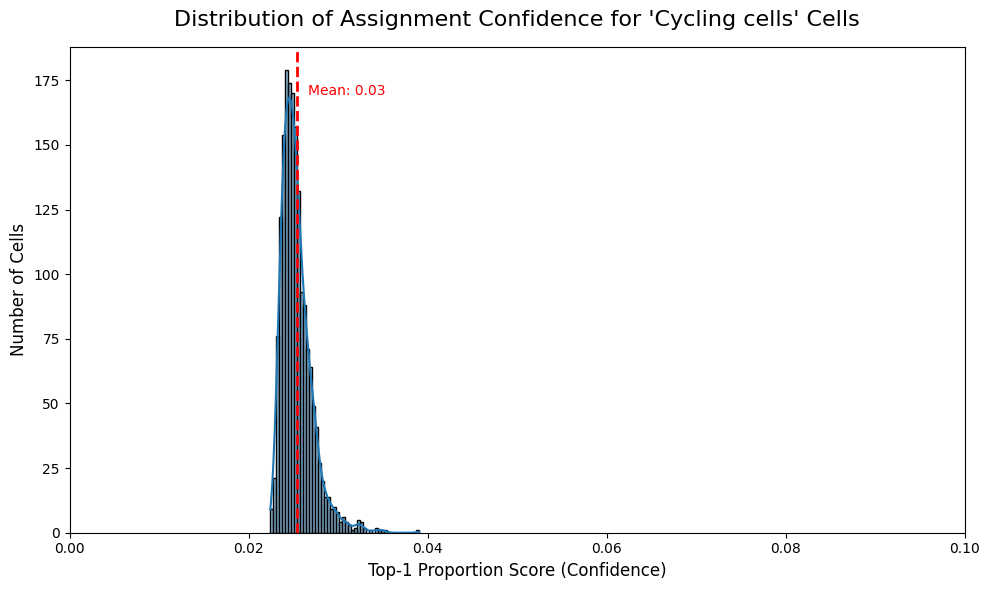

Generating confidence histogram for: 'Cycling myeloid'


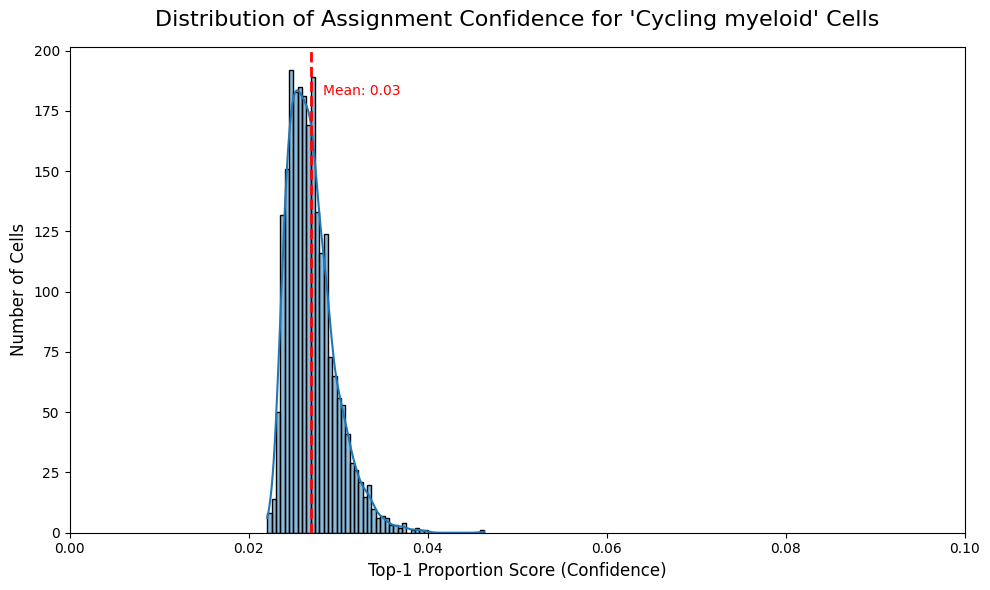

Generating confidence histogram for: 'DCs'


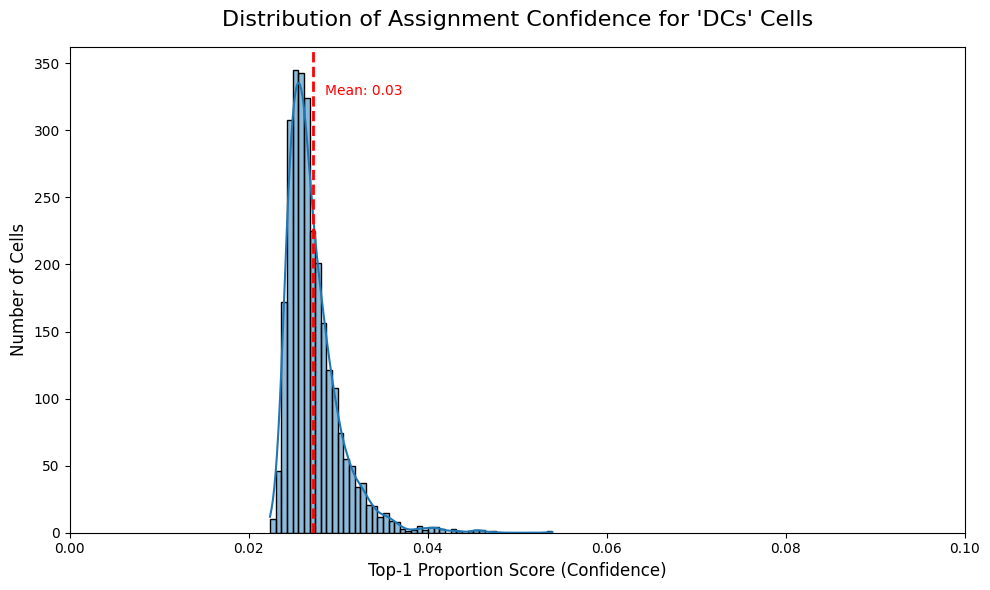

Generating confidence histogram for: 'DN'


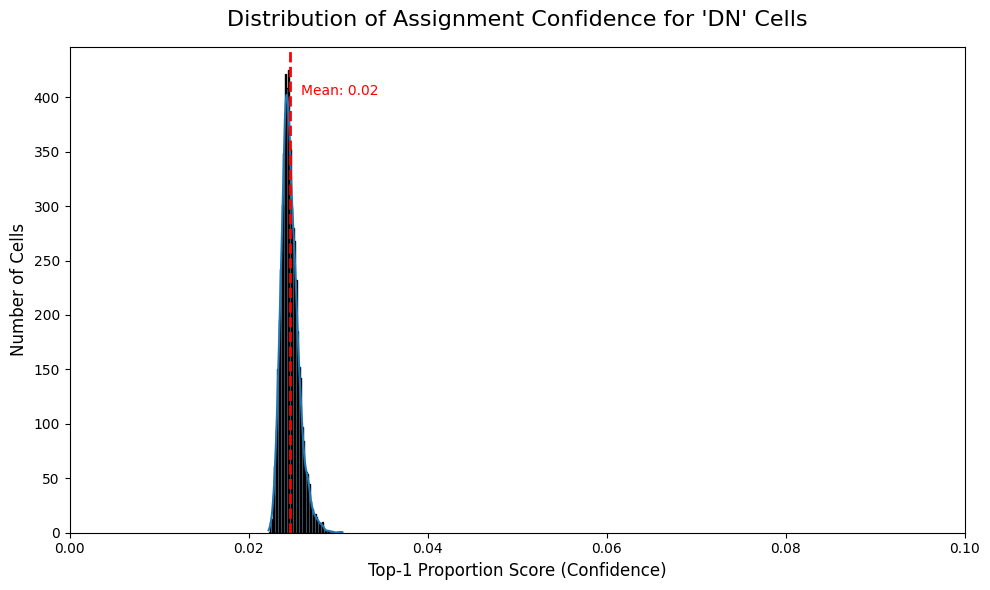

Generating confidence histogram for: 'Endothelium'


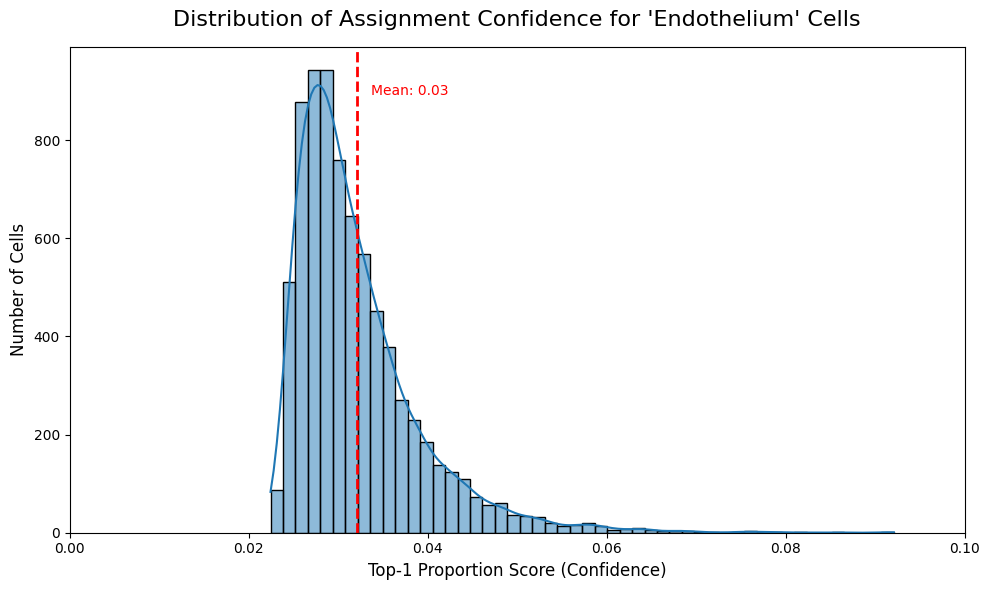

Generating confidence histogram for: 'Enteroendocrine'


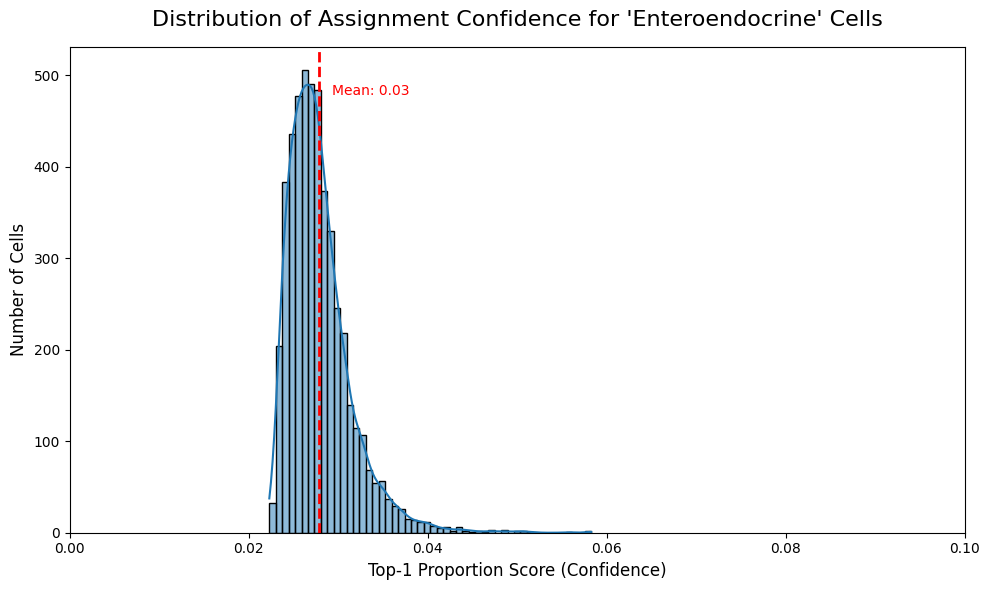

Generating confidence histogram for: 'Eosinophils'


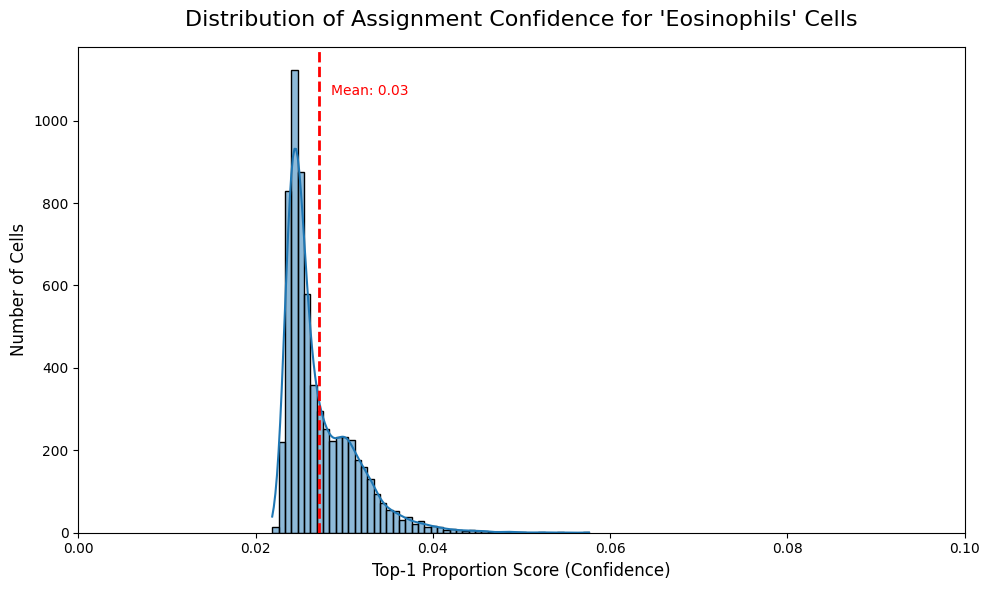

Generating confidence histogram for: 'Epithelium Ribhi'


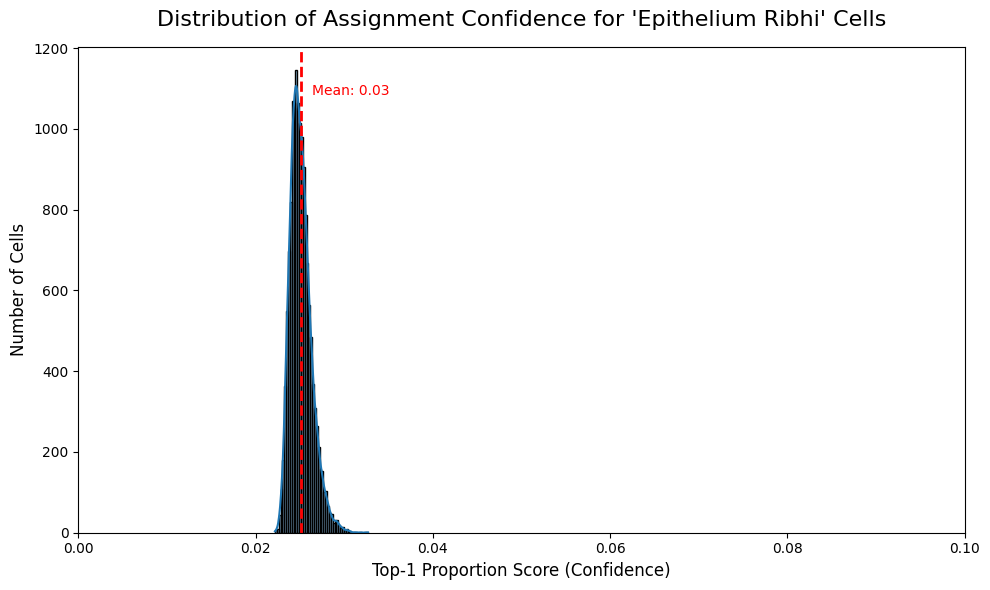

Generating confidence histogram for: 'FRCs'


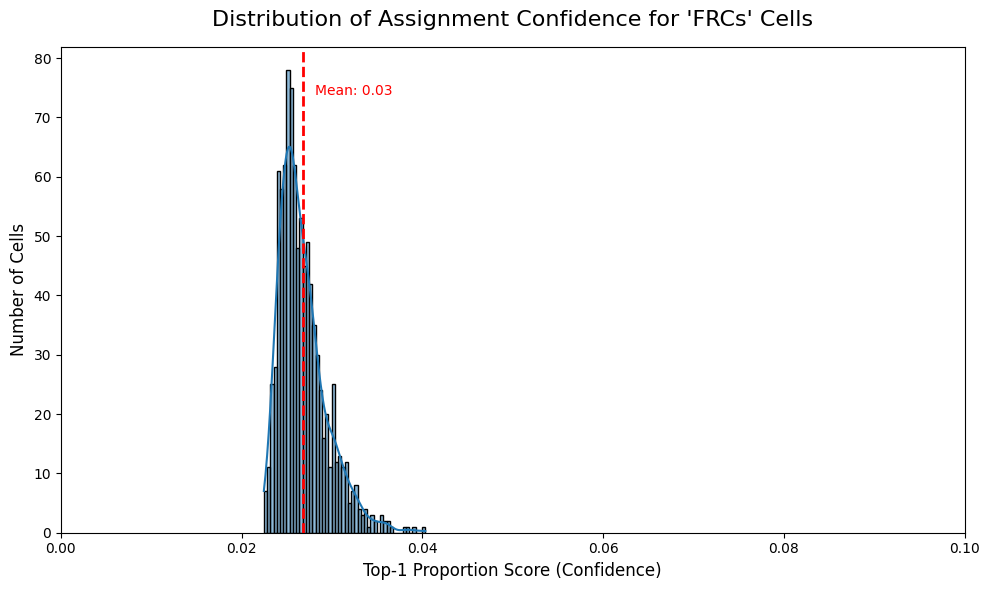

Generating confidence histogram for: 'Fibroblasts'


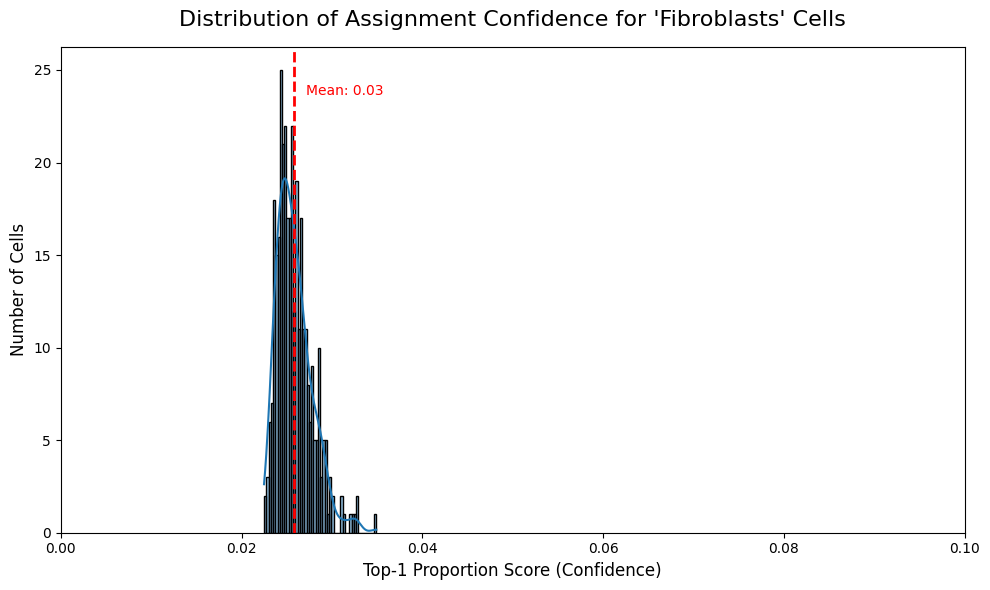

Generating confidence histogram for: 'GC B cell'


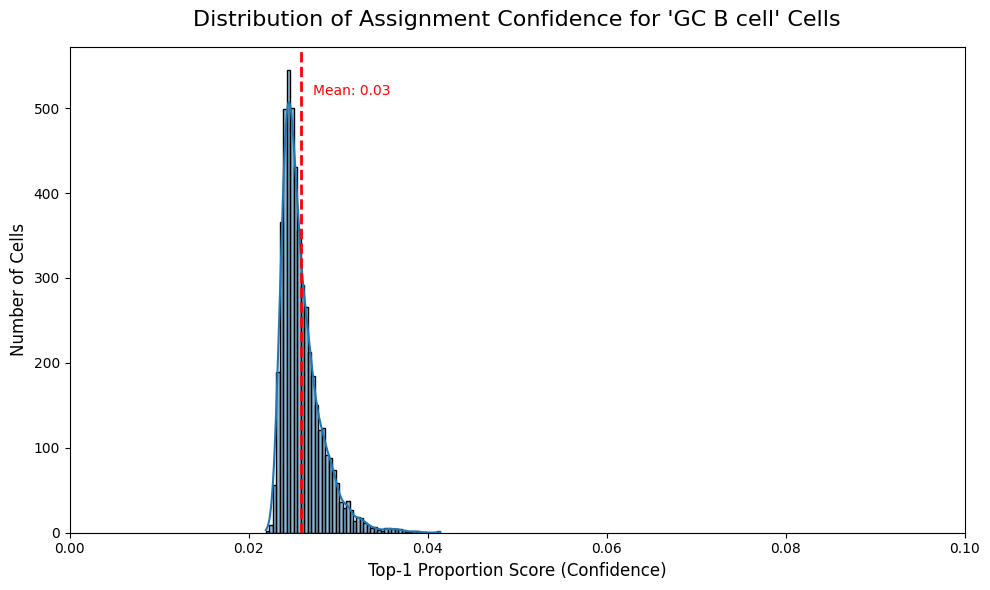

Generating confidence histogram for: 'Glia'


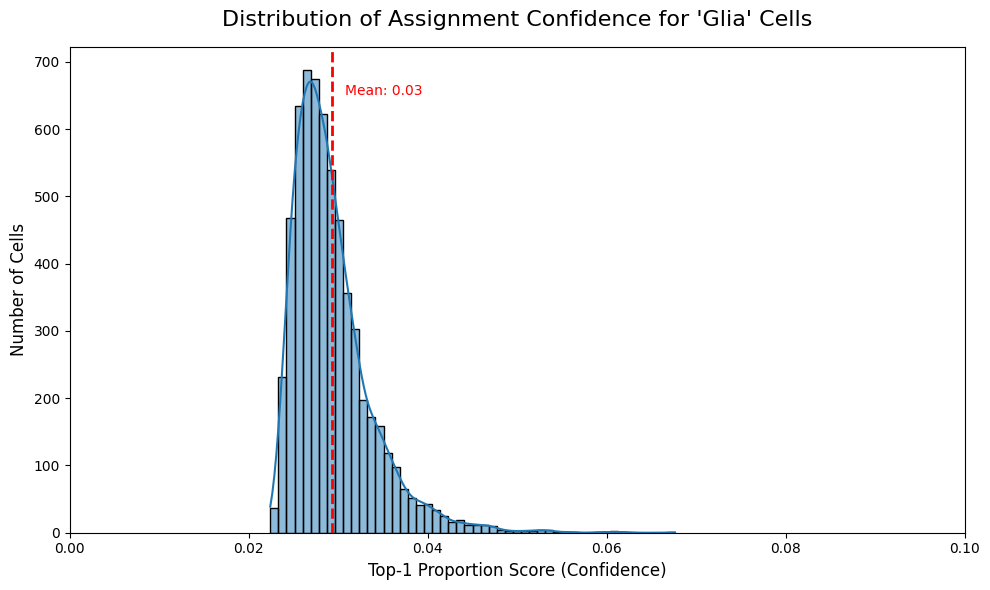

Generating confidence histogram for: 'Goblet'


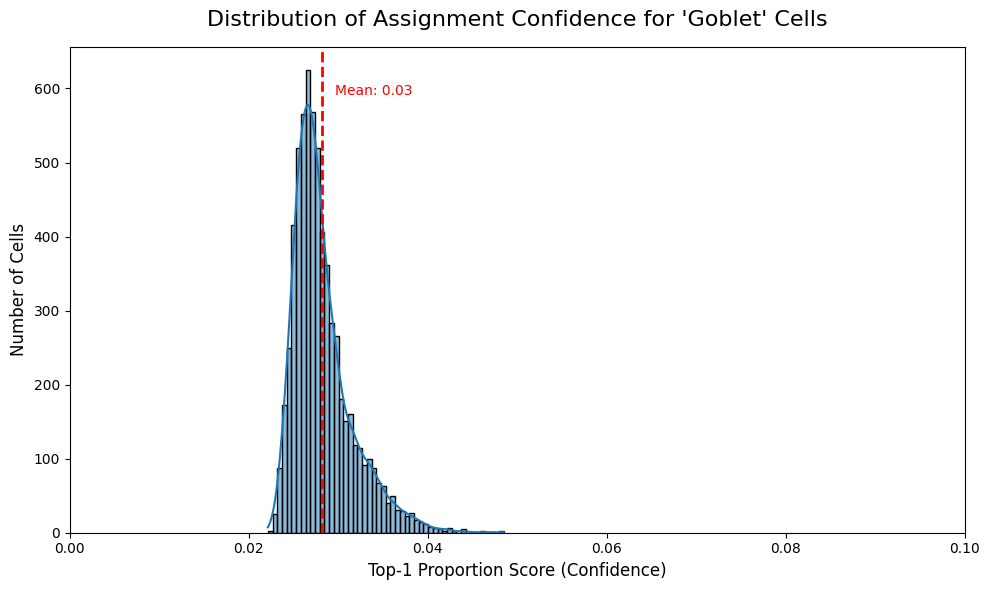

Generating confidence histogram for: 'IDA macrophage'


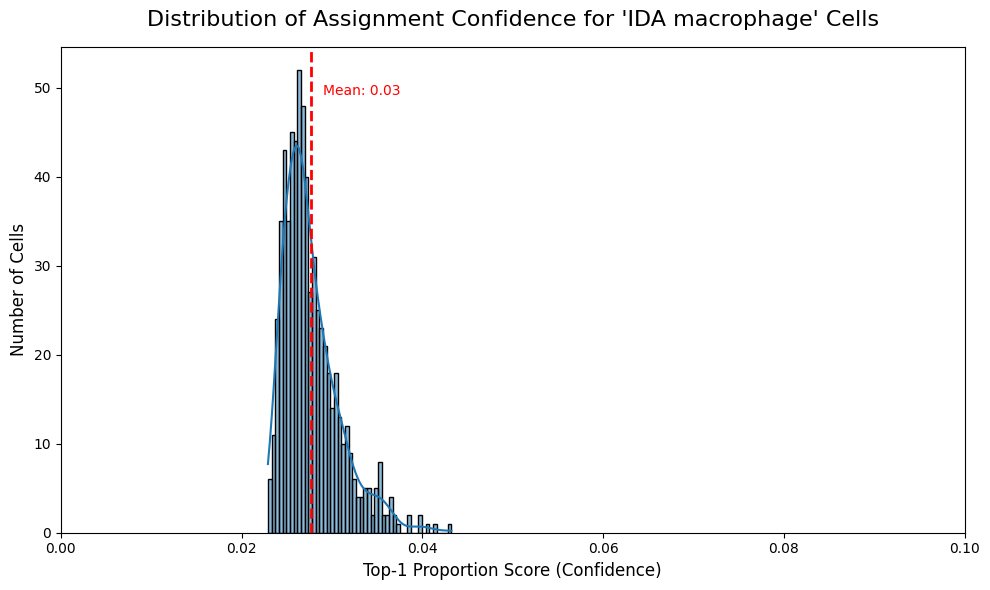

Generating confidence histogram for: 'ILC4'


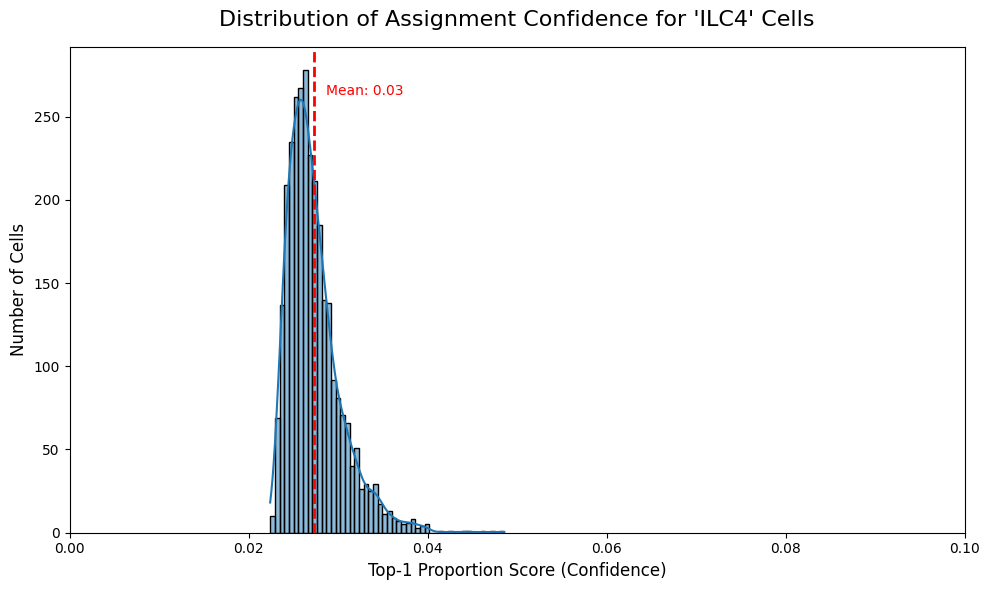

Generating confidence histogram for: 'Inflammatory fibroblasts'


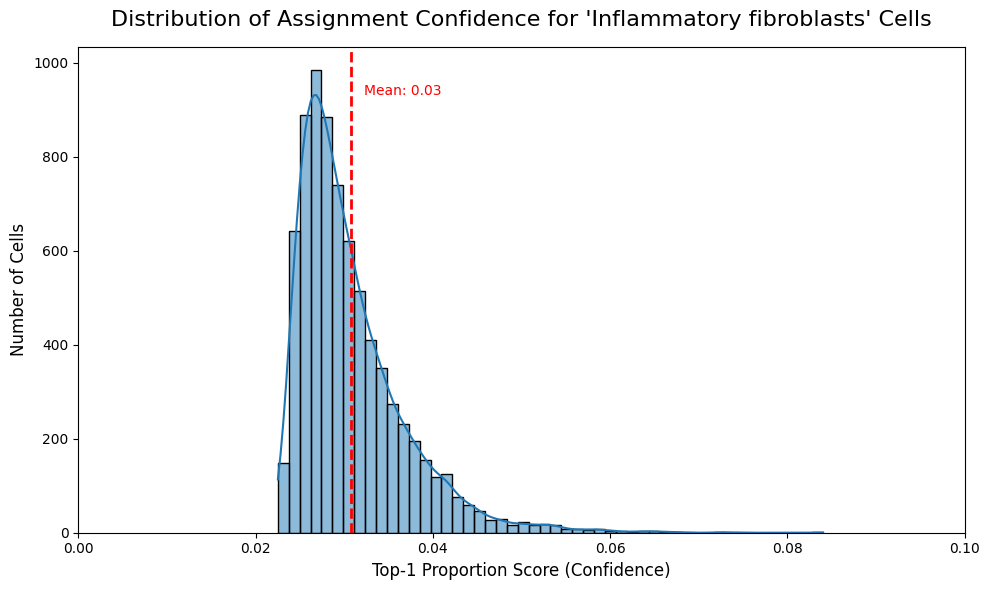

Generating confidence histogram for: 'Inflammatory monocytes'


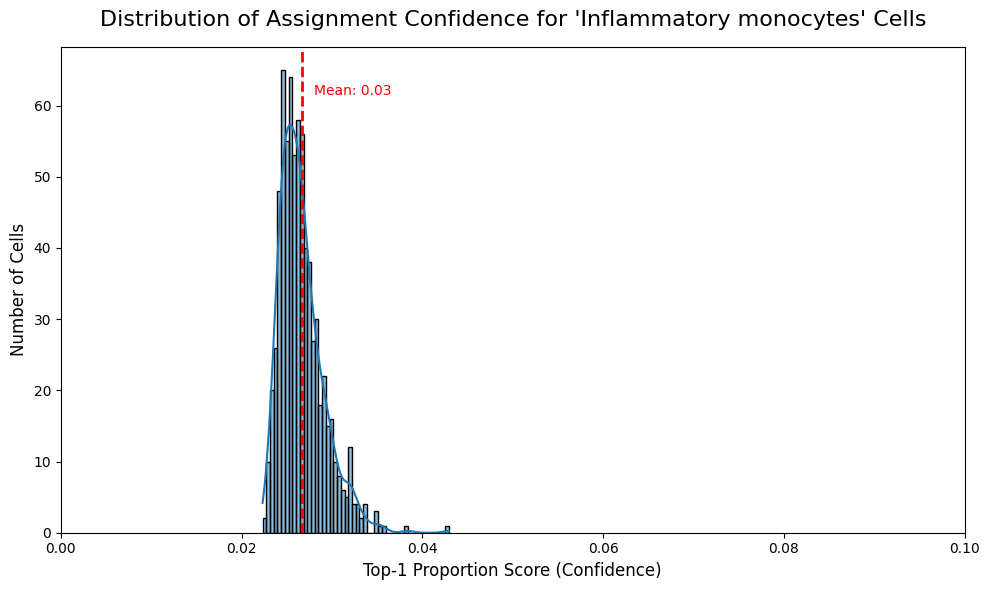

Generating confidence histogram for: 'M0'


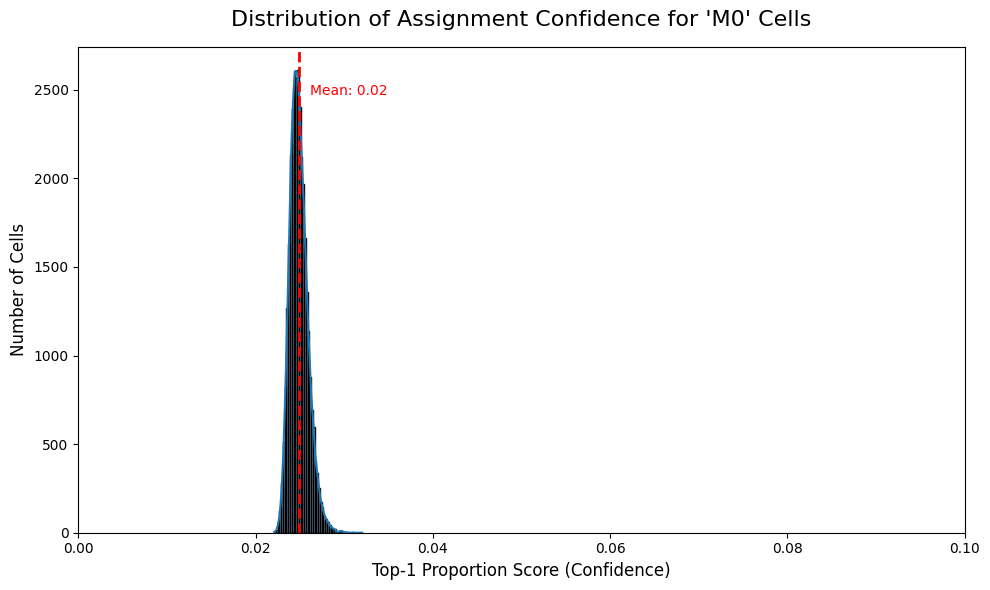

Generating confidence histogram for: 'M1'


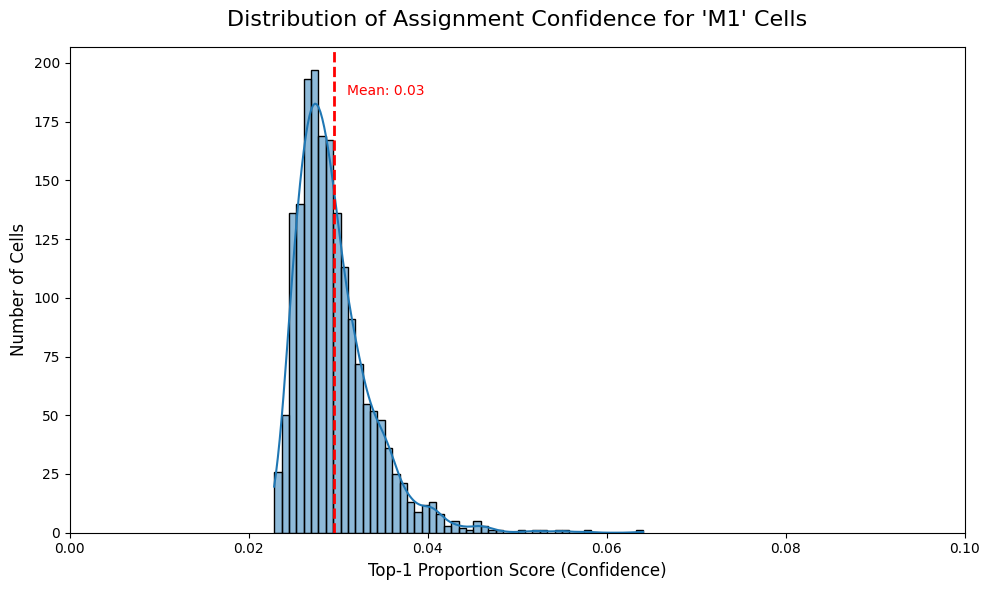

Generating confidence histogram for: 'M2'


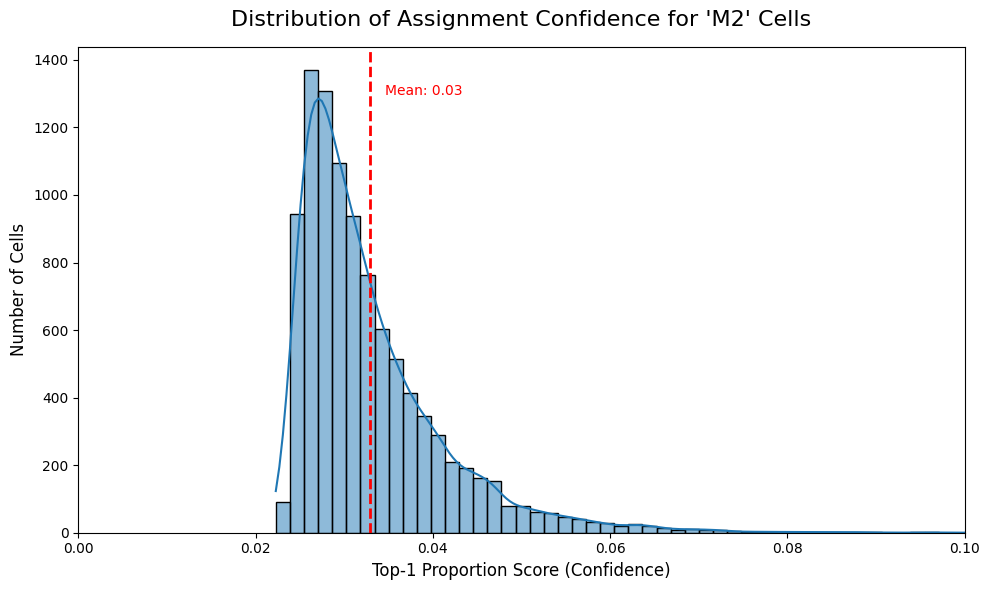

Generating confidence histogram for: 'MAIT'


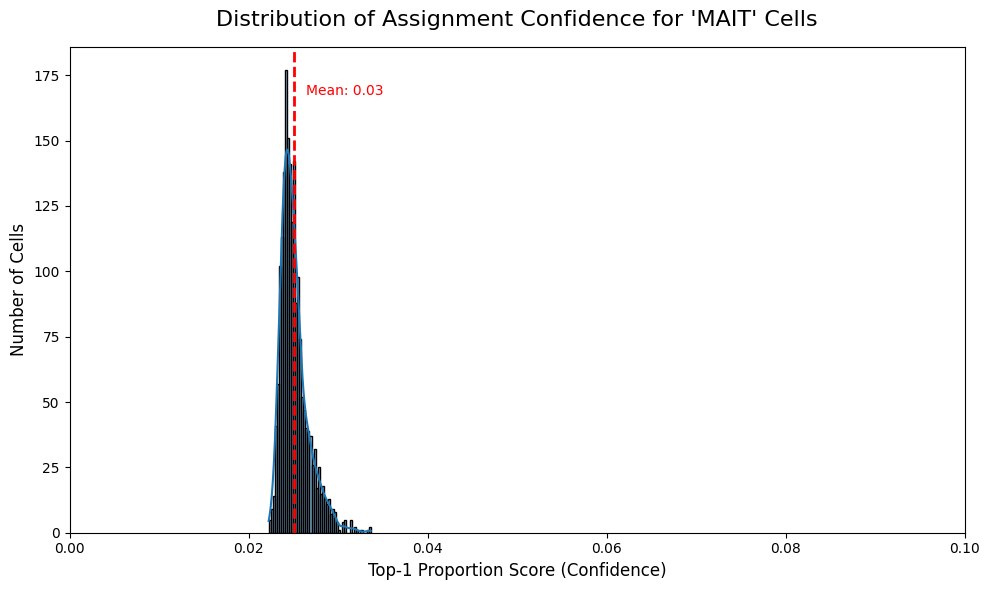

Generating confidence histogram for: 'MT T cells'


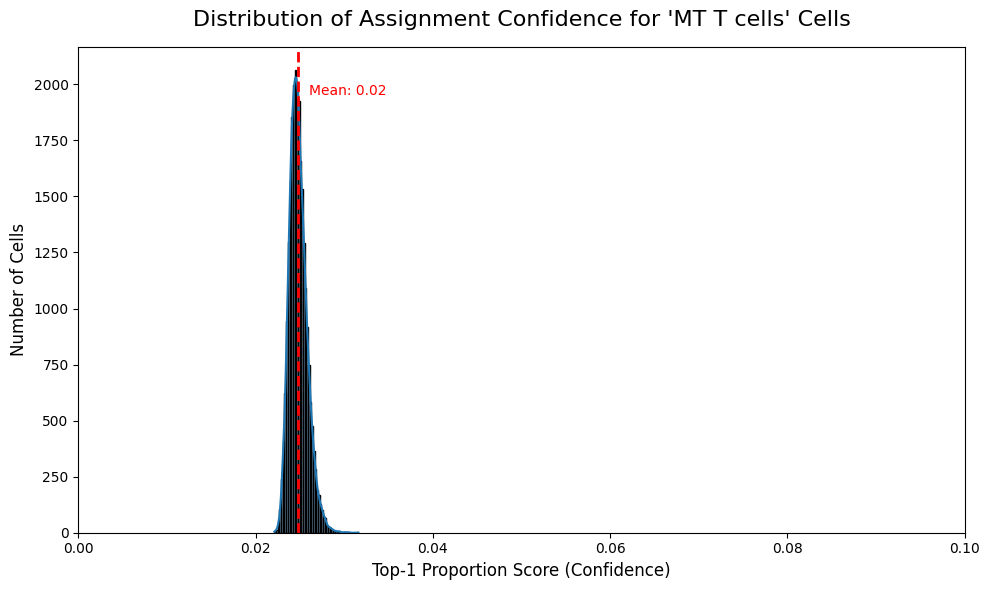

Generating confidence histogram for: 'Mast'


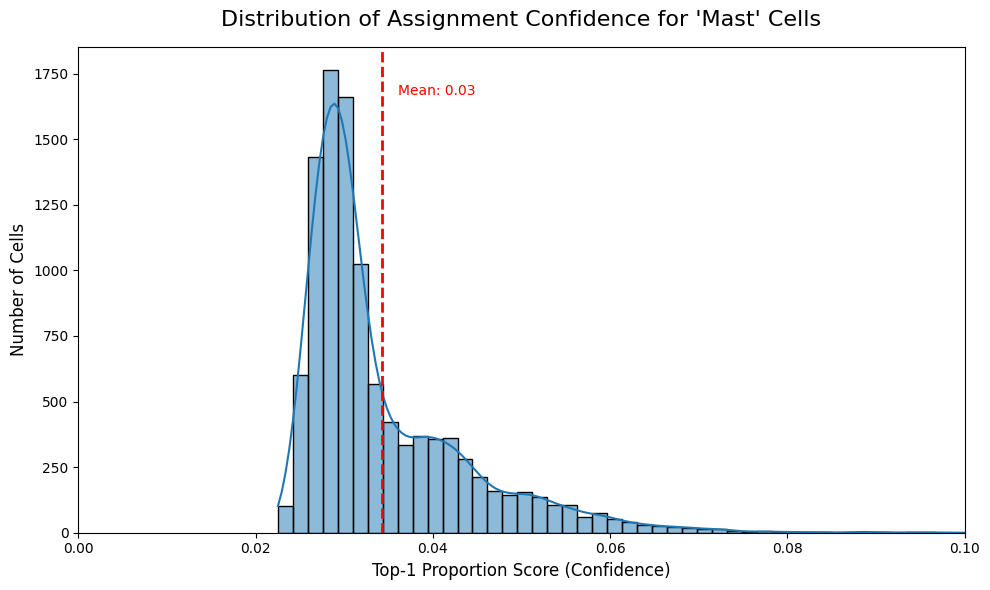

Generating confidence histogram for: 'Memory B cell'


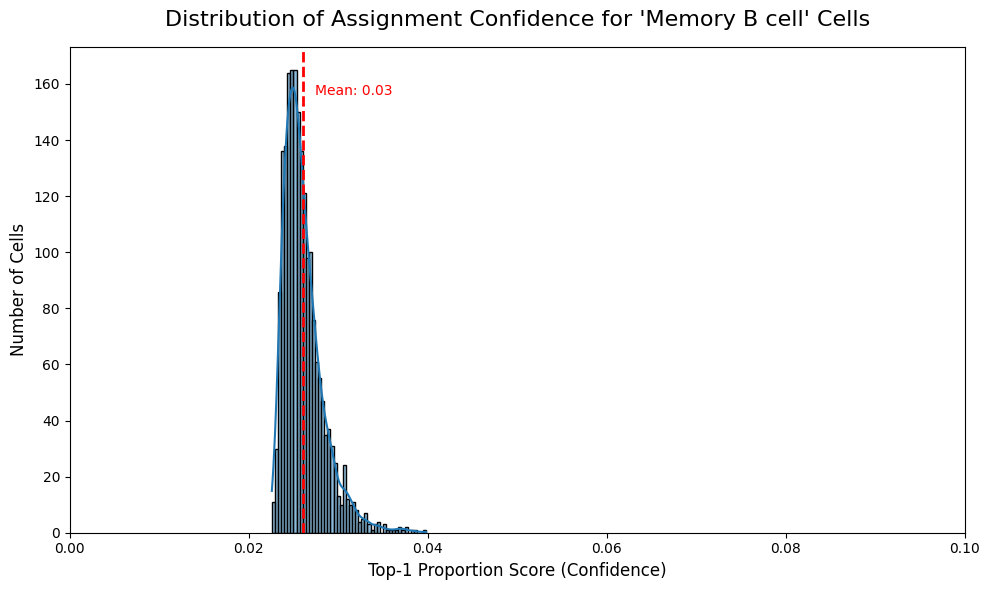

Generating confidence histogram for: 'Myofibroblasts'


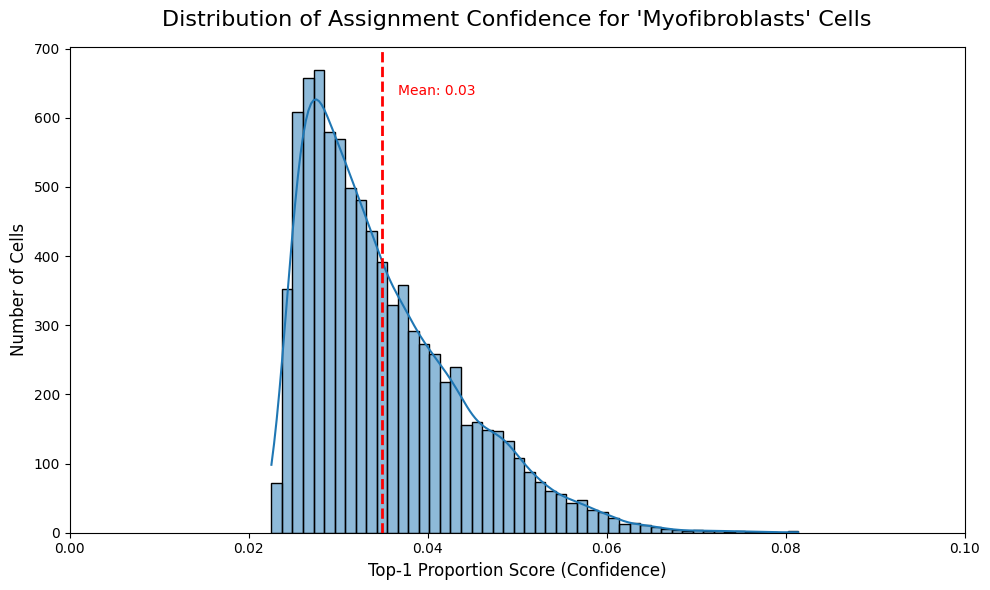

Generating confidence histogram for: 'N1'


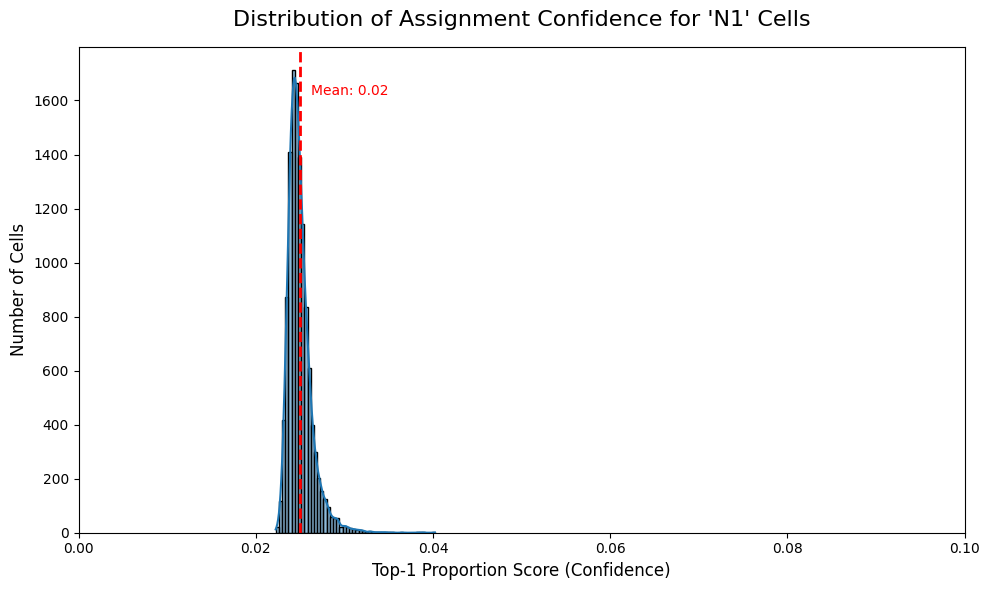

Generating confidence histogram for: 'N2'


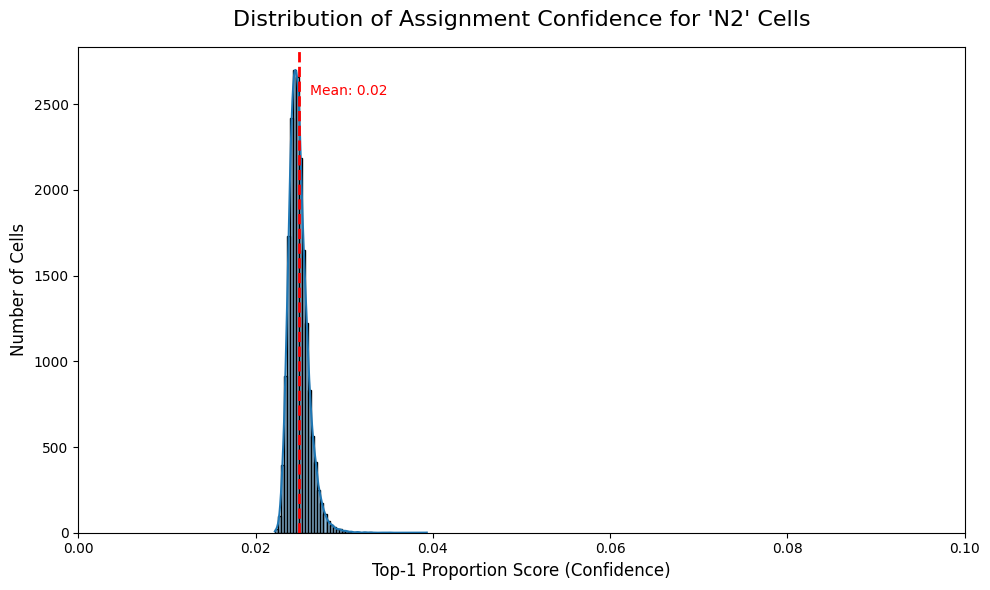

Generating confidence histogram for: 'N3'


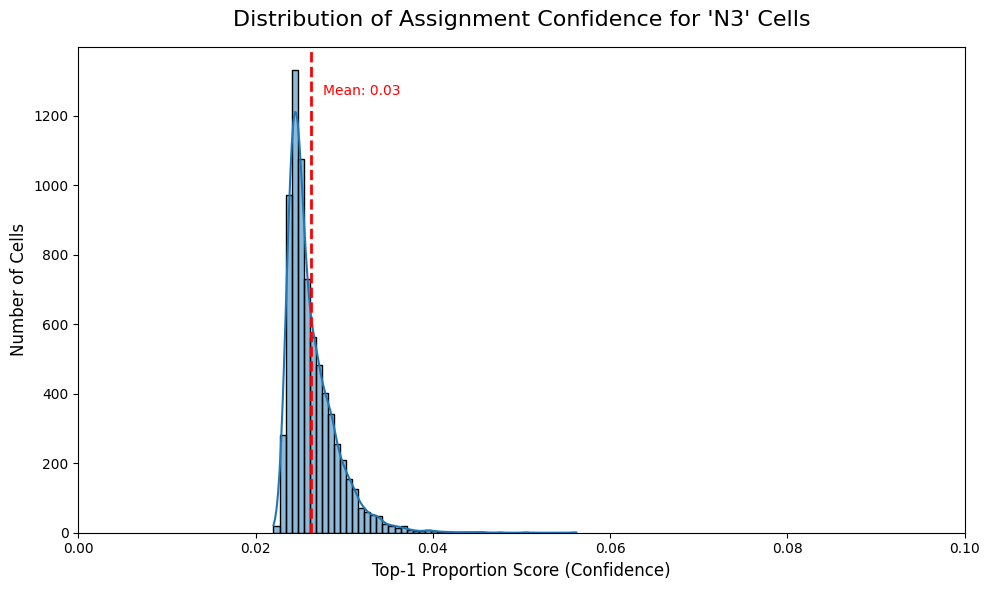

Generating confidence histogram for: 'NK'


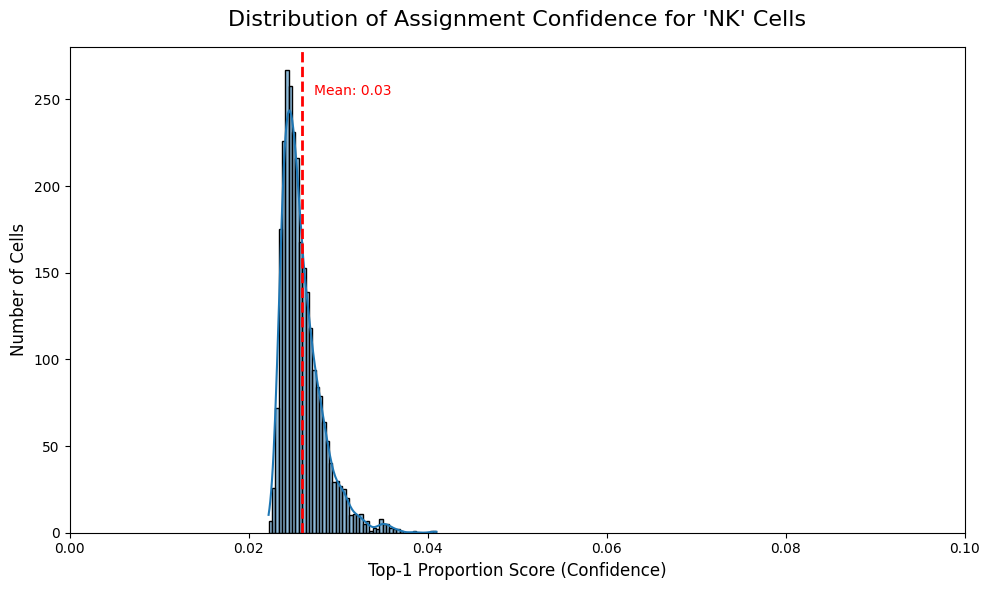

Generating confidence histogram for: 'Naïve B cell'


Generating confidence histogram for: 'PC  immediate early response'


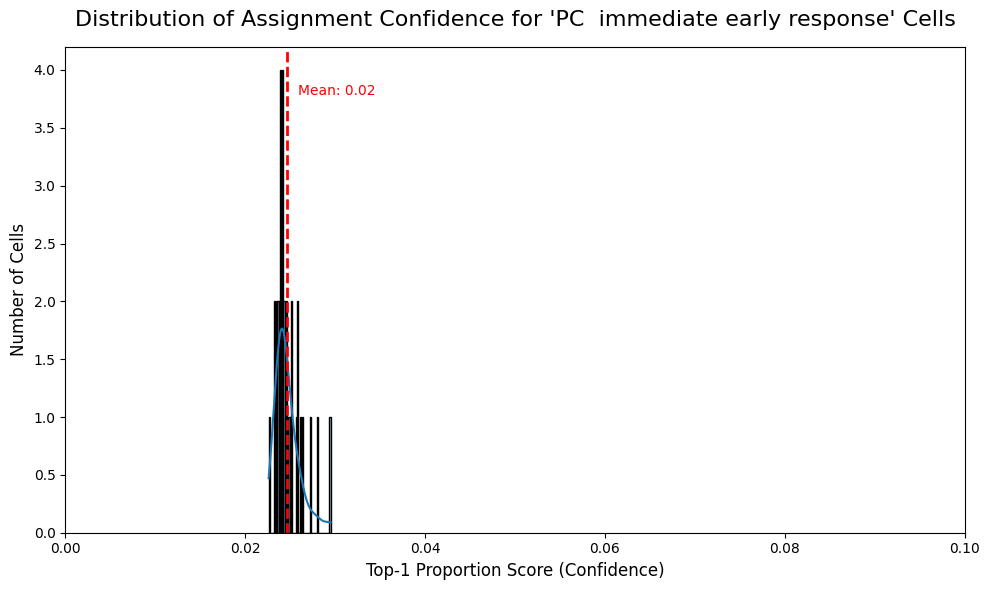

Generating confidence histogram for: 'PC IgA'


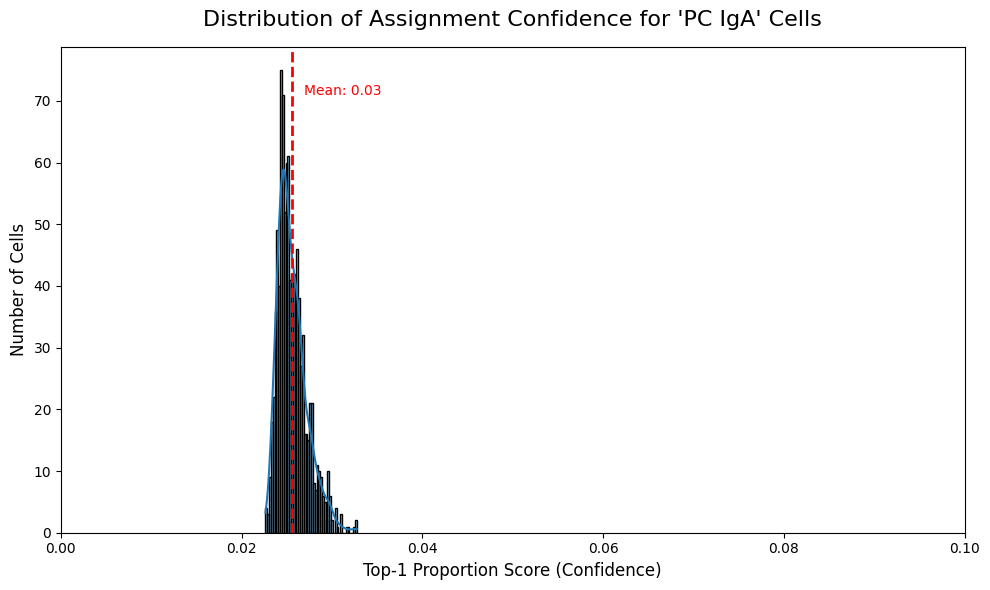

Generating confidence histogram for: 'PC IgA IgM'


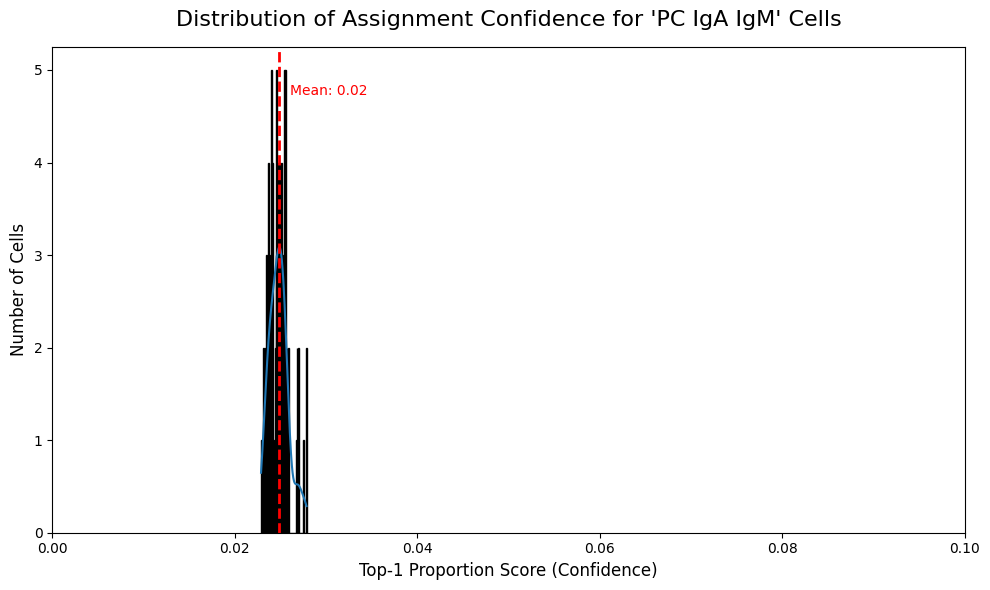

Generating confidence histogram for: 'PC IgA heat shock'


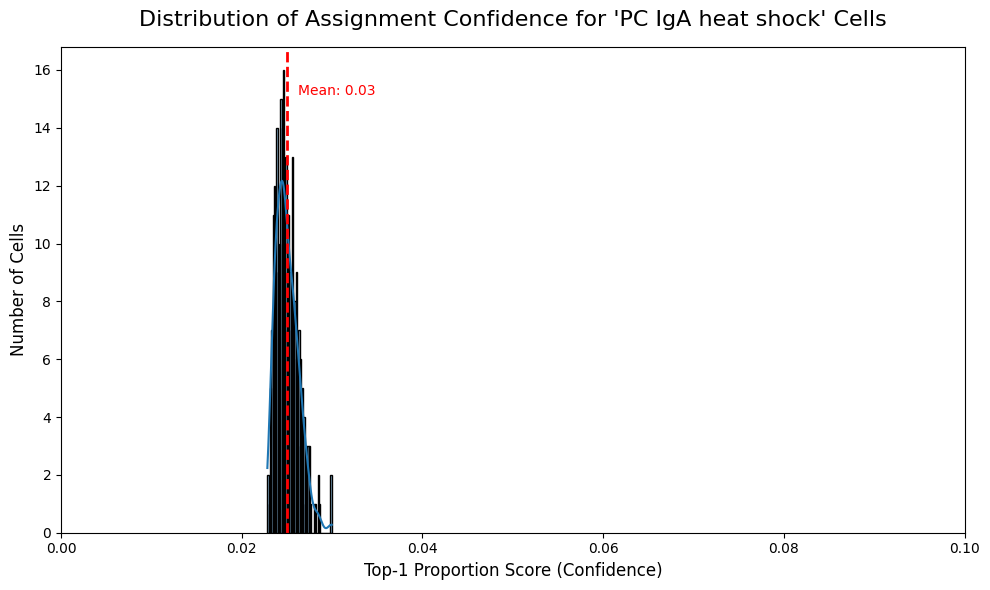

Generating confidence histogram for: 'PC IgG'


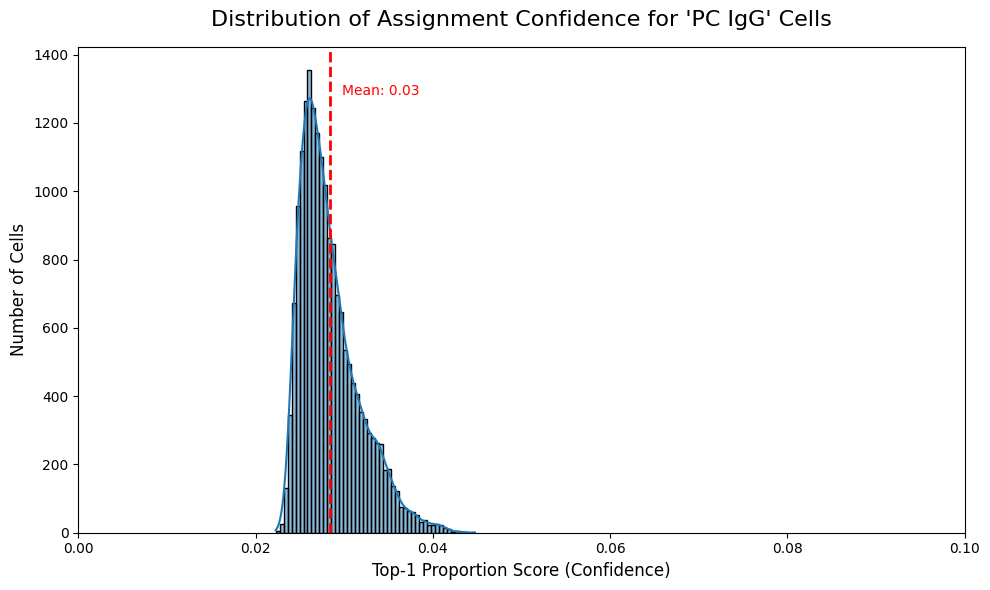

Generating confidence histogram for: 'Paneth-like'


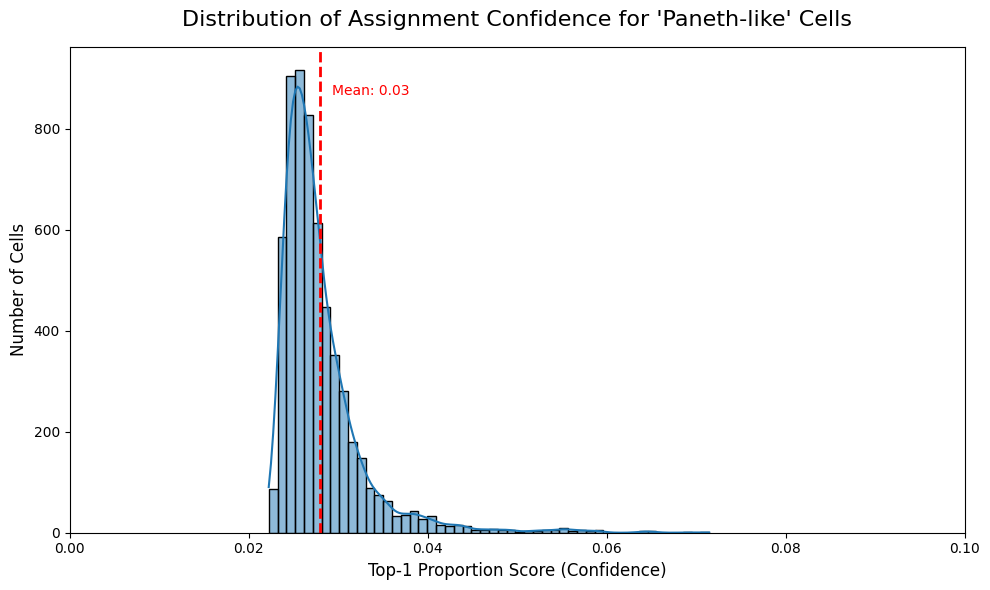

Generating confidence histogram for: 'Pericytes'


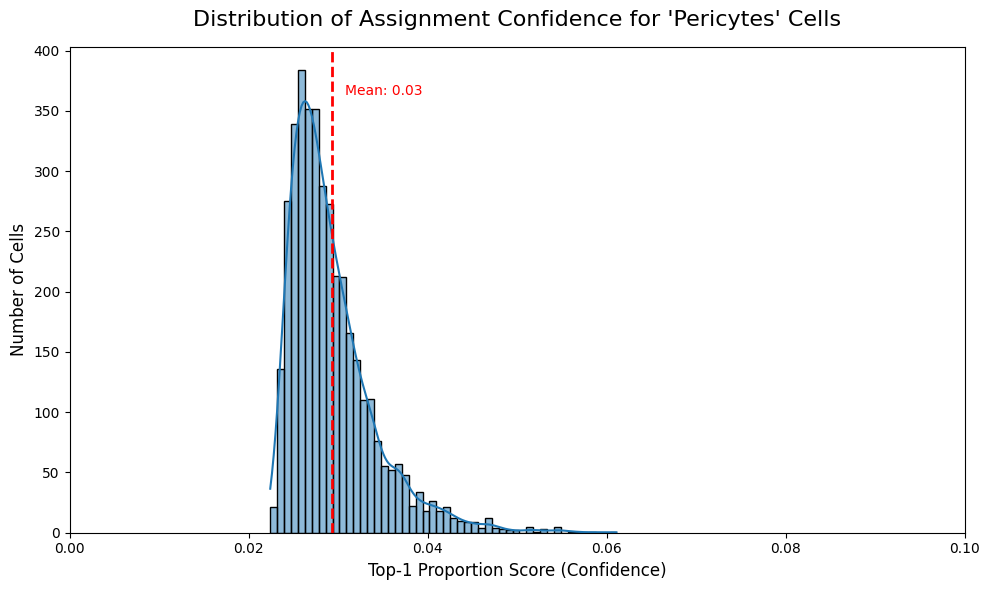

Generating confidence histogram for: 'Ribhi T cells'


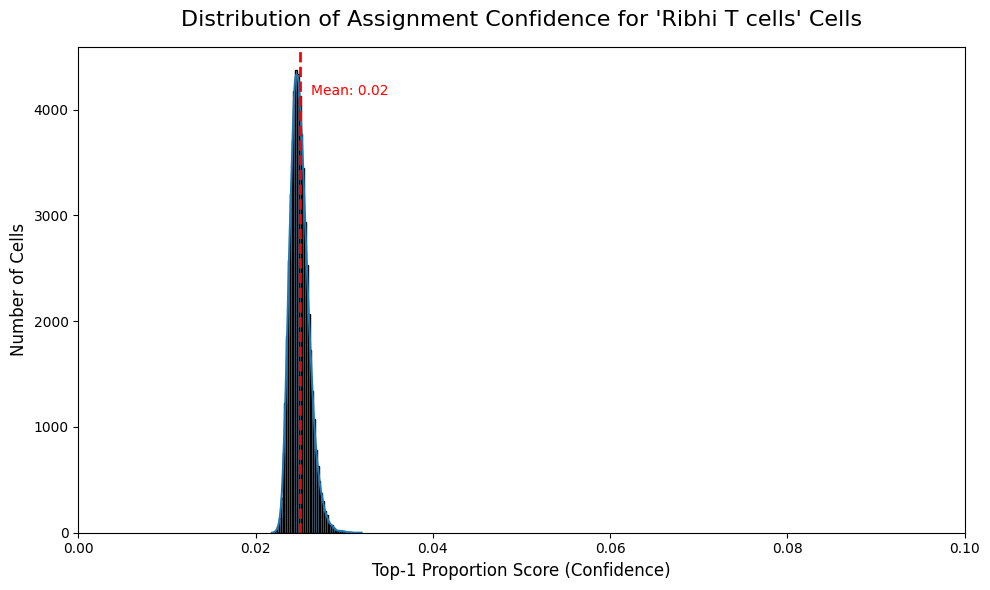

Generating confidence histogram for: 'S1'


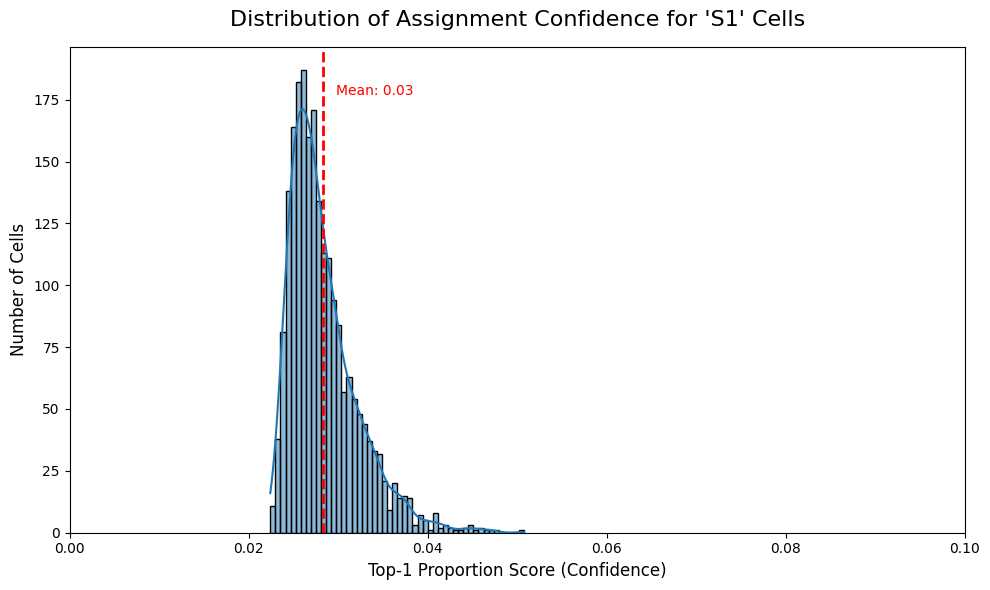

Generating confidence histogram for: 'S2a'


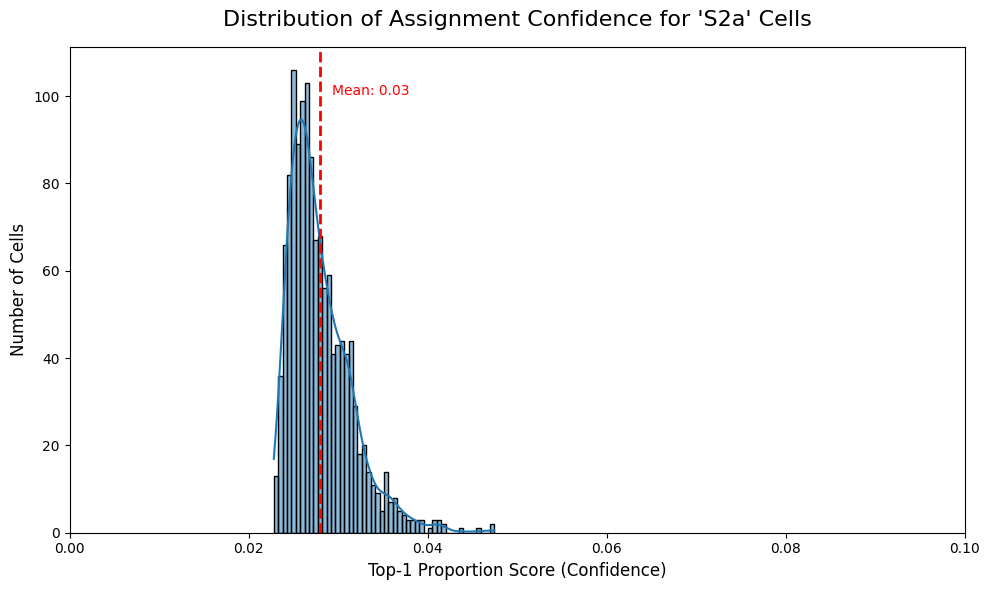

Generating confidence histogram for: 'S2b'


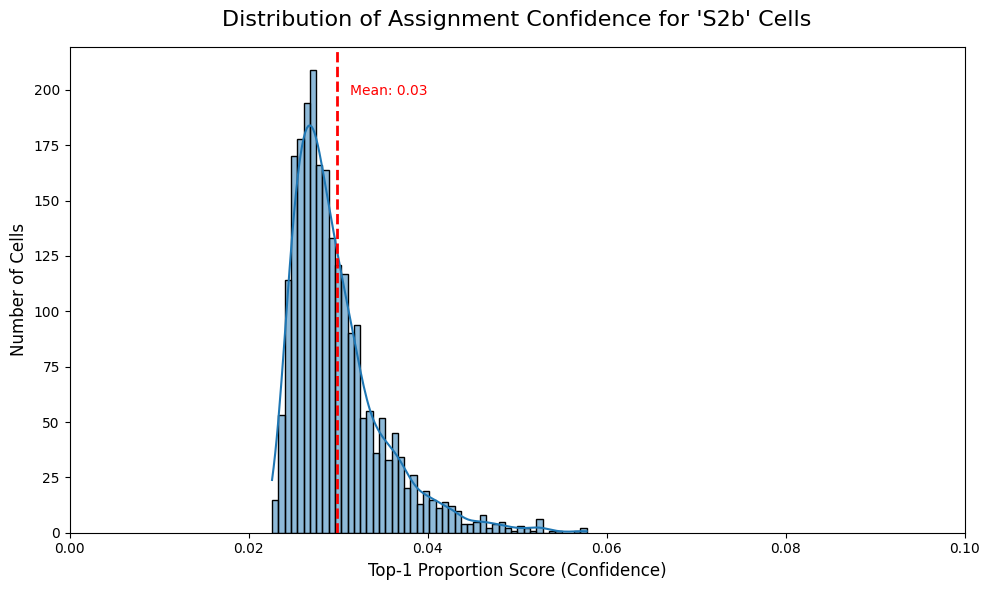

Generating confidence histogram for: 'S3'


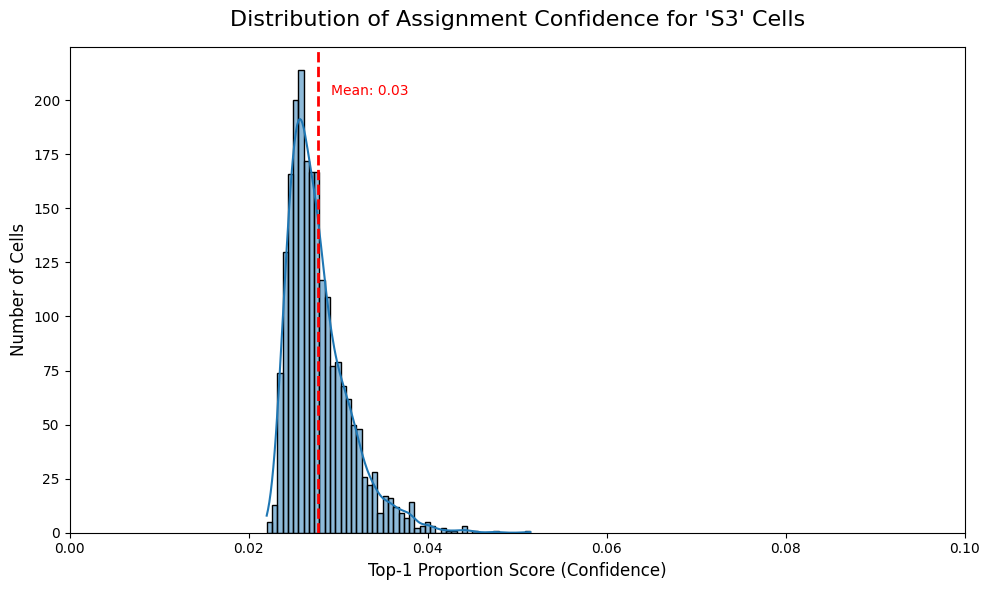

Generating confidence histogram for: 'Secretory progenitor'


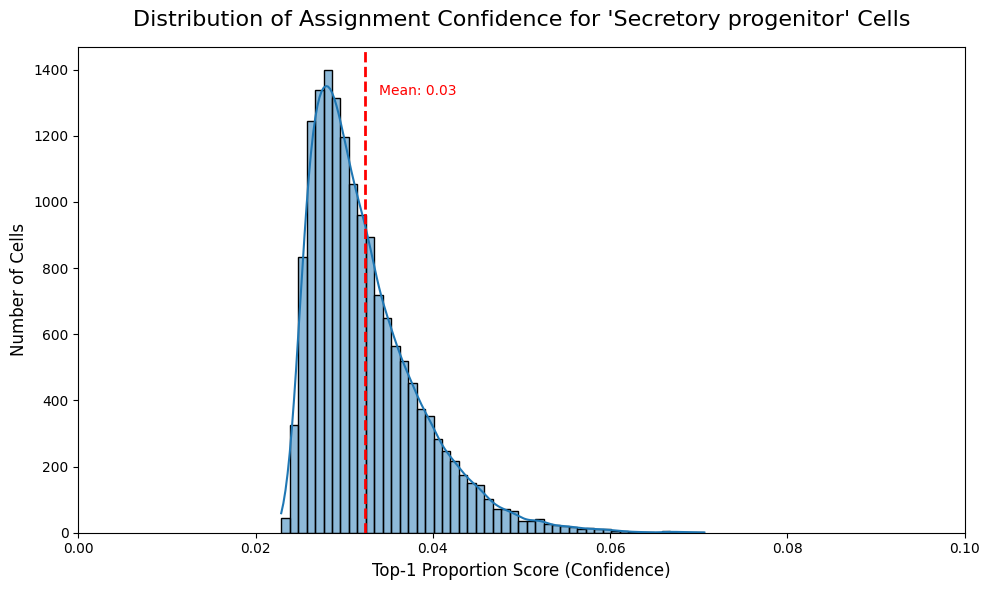

Generating confidence histogram for: 'T cells CCL20'


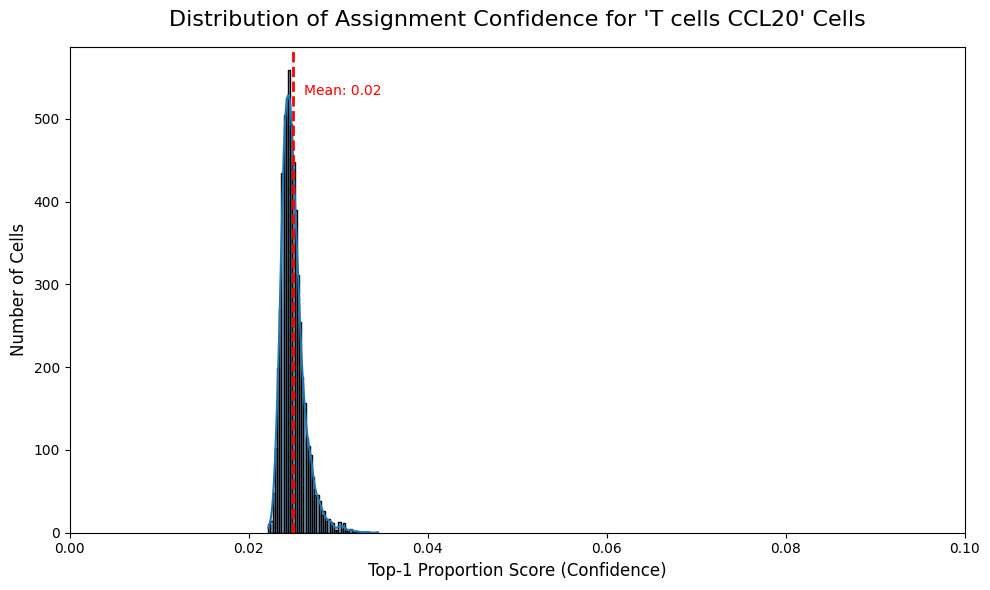

Generating confidence histogram for: 'Tregs'


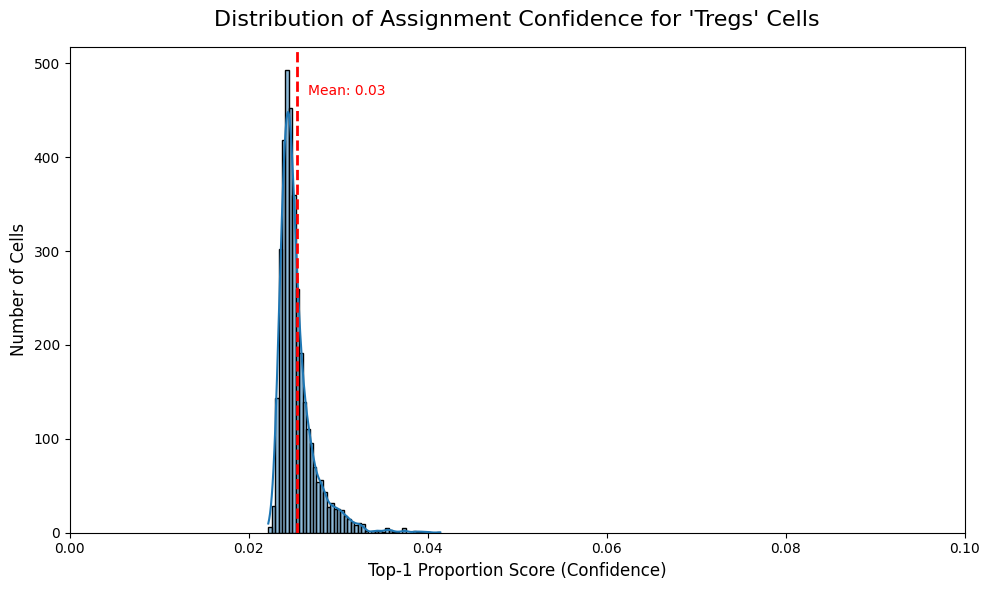

Generating confidence histogram for: 'Tuft cells'


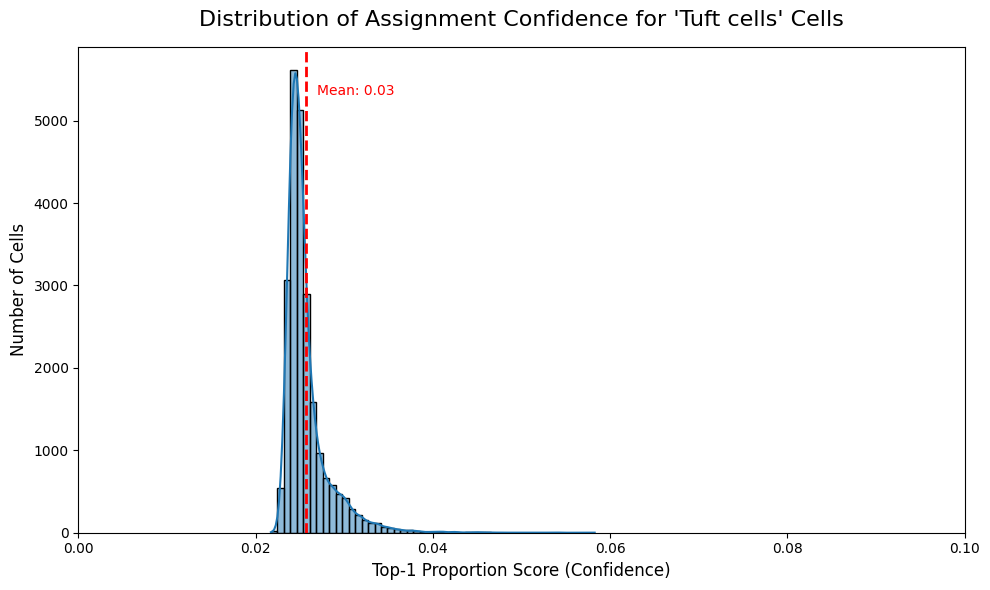

Generating confidence histogram for: 'gd IEL'


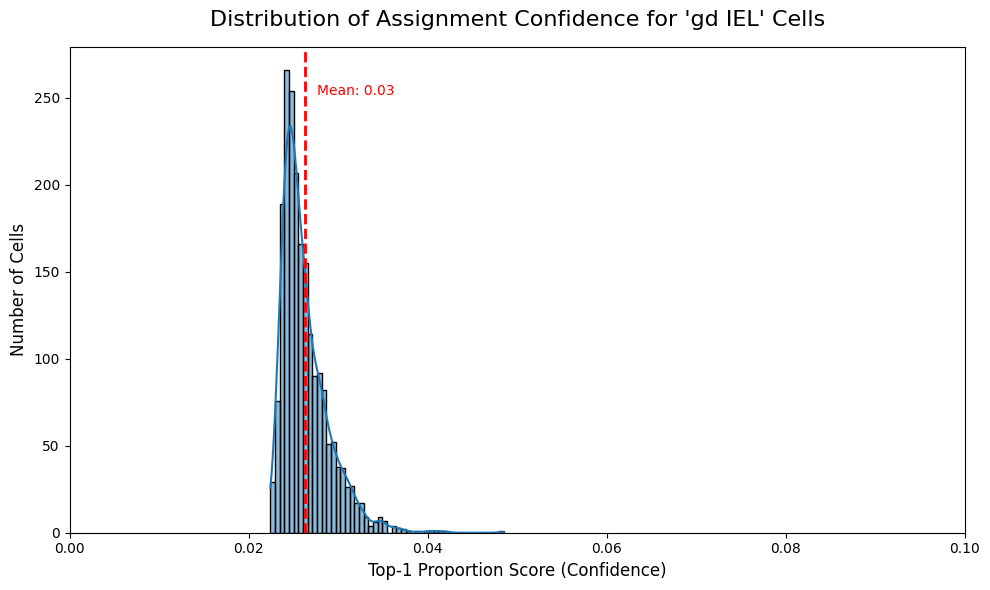


--- Analysis Complete ---


In [21]:
# --- 1. Load the Proportions Data ---
path_to_proportions_csv = '/blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances_proportions.csv'

print("--- Part 1: Loading Data and Preparing for Analysis ---")

try:
    df_props = pd.read_csv(path_to_proportions_csv, index_col=0)
    print(f"Successfully loaded proportions data from: {path_to_proportions_csv}")
except FileNotFoundError:
    print(f"FATAL ERROR: The file was not found at '{path_to_proportions_csv}'")
    # exit() # This would stop a script

# --- 2. Prepare Data for Plotting ---

# Get the list of columns that contain the proportion values
numeric_cols = df_props.columns.tolist()

# A) For each cell, determine its assigned type (the column with the highest proportion)
print("Determining assigned cell type for each cell...")
df_props['assigned_type'] = df_props[numeric_cols].idxmax(axis=1)

# B) For each cell, find its top score (the value of its highest proportion)
print("Calculating the top-1 proportion score (confidence) for each cell...")
df_props['top_score'] = df_props[numeric_cols].max(axis=1)
print("Preparation complete.")


# --- 3. Generate a Confidence Histogram for Each Cell Type ---

print("\n--- Part 2: Generating Histograms of Assignment Confidence ---")

# Get the list of unique cell types that were actually assigned to cells
unique_assigned_types = sorted(df_props['assigned_type'].unique())
output_dir = os.path.dirname(path_to_proportions_csv)

for cell_type in unique_assigned_types:
    print(f"Generating confidence histogram for: '{cell_type}'")

    plt.figure(figsize=(10, 6))
    ax = plt.gca()

    # Filter the DataFrame to get only the cells assigned to the current cell_type
    subset_df = df_props[df_props['assigned_type'] == cell_type]

    # Create the histogram of the 'top_score' for this subset
    sns.histplot(
        data=subset_df,
        x='top_score',
        bins=50,      # Use 50 bins for a detailed view between 0 and 1
        kde=True,     # Add a density line to show the distribution shape
        ax=ax
    )

    # --- Improve the plot ---
    ax.set_title(f"Distribution of Assignment Confidence for '{cell_type}' Cells", fontsize=16, pad=15)
    ax.set_xlabel("Top-1 Proportion Score (Confidence)", fontsize=12)
    ax.set_ylabel("Number of Cells", fontsize=12)
    
    # Set a consistent x-axis range for easy comparison between plots
    ax.set_xlim(0, 0.1)

    # Add a vertical line at the mean confidence
    mean_confidence = subset_df['top_score'].mean()
    ax.axvline(mean_confidence, color='red', linestyle='--', linewidth=2)
    ax.text(mean_confidence * 1.05, ax.get_ylim()[1] * 0.9, f'Mean: {mean_confidence:.2f}', color='red')

    plt.tight_layout()

    # --- Save the figure ---
    # Sanitize filename by replacing spaces and slashes
    safe_filename = f"Confidence_Histogram_{cell_type.replace(' ', '_').replace('/', '_')}.png"
    output_path = os.path.join(output_dir, safe_filename)
    plt.savefig(output_path, dpi=150)
    
    plt.show()

print("\n--- Analysis Complete ---")

--- Part 1: Loading Data and Preparing for Analysis ---
Successfully loaded proportions data from: /blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances_proportions.csv
Determining assigned cell type for each cell...
Preparation complete.

--- Part 2: Counting Number of Competing Cell Types per Cell ---
Calculating the number of competing types for each cell...
Calculation complete.

--- Part 3: Generating Grid of Histograms ---

Customizing x-axis ticks...

Saved composite plot to /blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/Competing_Types_Grid_Custom_Ticks.png


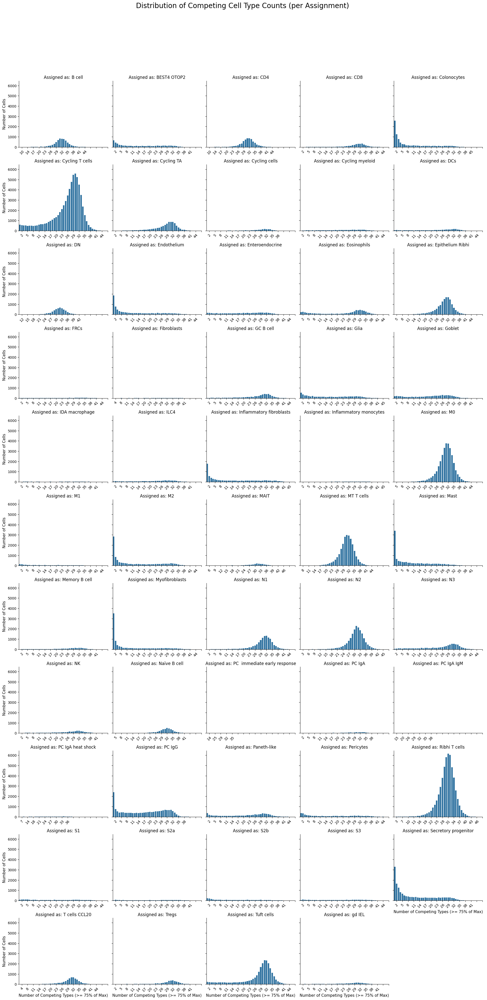


--- Analysis Complete ---


In [24]:
# --- 1. Load the Proportions Data ---
path_to_proportions_csv = '/blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances_proportions.csv'

print("--- Part 1: Loading Data and Preparing for Analysis ---")
try:
    df_props = pd.read_csv(path_to_proportions_csv, index_col=0)
    print(f"Successfully loaded proportions data from: {path_to_proportions_csv}")
except FileNotFoundError:
    print(f"FATAL ERROR: The file was not found at '{path_to_proportions_csv}'")
    # exit()

# --- 2. Prepare Data for Analysis ---
numeric_cols = df_props.columns.tolist()
print("Determining assigned cell type for each cell...")
df_props['assigned_type'] = df_props[numeric_cols].idxmax(axis=1)
print("Preparation complete.")

# --- 3. Analyze Number of Competing Cell Types ---
print("\n--- Part 2: Counting Number of Competing Cell Types per Cell ---")
def count_competing_types(row_of_scores):
    max_score = row_of_scores.max()
    if max_score == 0:
        return 0
    threshold = 0.75 * max_score
    num_competing = (row_of_scores >= threshold).sum()
    return num_competing

print("Calculating the number of competing types for each cell...")
df_props['num_competing_types'] = df_props[numeric_cols].apply(
    count_competing_types,
    axis=1
)
print("Calculation complete.")

# --- 4. Generate Visualization Grid ---
print("\n--- Part 3: Generating Grid of Histograms ---")
plot_order = sorted(df_props['assigned_type'].unique())
g = sns.catplot(
    data=df_props,
    x='num_competing_types',
    col='assigned_type',
    col_order=plot_order,
    kind='count',
    col_wrap=5,
    height=3.5,
    aspect=1.1,
    sharex=False
)

# --- Improve the plot ---
g.fig.suptitle("Distribution of Competing Cell Type Counts (per Assignment)", y=1.03, fontsize=20)
g.set_titles("Assigned as: {col_name}", size=12)
g.set_axis_labels("Number of Competing Types (>= 75% of Max)", "Number of Cells", size=11)

# --- NEW SECTION: Customize X-Axis Ticks ---
print("\nCustomizing x-axis ticks...")
# Determine the max value on the x-axis to set the range
max_x_value = df_props['num_competing_types'].max()

# Generate new ticks starting at 1, going to the max value, with a step of 3
new_ticks = np.arange(1, max_x_value + 1, 3)

# Iterate through each subplot (Axes object) in the grid and apply the new ticks
for ax in g.axes.flat:
    ax.set_xticks(new_ticks)
    # Optional: ensure labels are readable if they become dense
    ax.tick_params(axis='x', labelrotation=45) 
# --- END NEW SECTION ---

plt.tight_layout(rect=[0, 0, 1, 0.97])

# --- 5. Save the figure ---
output_dir = os.path.dirname(path_to_proportions_csv)
output_filename = "Competing_Types_Grid_Custom_Ticks.png"
output_path = os.path.join(output_dir, output_filename)
plt.savefig(output_path, dpi=150)
print(f"\nSaved composite plot to {output_path}")
plt.show()

print("\n--- Analysis Complete ---")

In [28]:
# --- Import Required Libraries ---
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# --- Define File Paths ---
# MODIFIED: Using the proportions file directly
input_csv = '/blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances_proportions.csv'
# MODIFIED: Saving to a new, dedicated folder
output_dir = '/blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/Top2_vs_Top1_ScatterPlots_withDiagonals'

os.makedirs(output_dir, exist_ok=True)
print("--- Starting Top1 vs Top2 Scatter Plot Generation with Diagonals ---")

# --- Load Data ---
print(f"Loading data from: {input_csv}")
df_props = pd.read_csv(input_csv, index_col=0)
print("Data loaded successfully.")

# --- Compute top-1 and top-2 scores ---
# NOTE: The relative abundance calculation is skipped.
numeric_cols = df_props.columns.tolist()
sorted_abundances = np.sort(df_props.values, axis=1)[:, ::-1]
df_props['top1'] = sorted_abundances[:, 0]
df_props['top2'] = sorted_abundances[:, 1]
df_props['assigned_type'] = df_props[numeric_cols].idxmax(axis=1)

# --- Generate Scatter Plots ---
unique_assigned_types = sorted(df_props['assigned_type'].unique())
for cell_type in unique_assigned_types:
    print(f"Generating scatter plot for: '{cell_type}'")
    subset_df = df_props[df_props['assigned_type'] == cell_type]

    # Dynamic axis limits
    max_x = subset_df['top1'].max()
    max_y = subset_df['top2'].max()
    xlim = (0, min(1.01, max_x + 0.01))
    ylim = (0, min(1.01, max_y + 0.01))

    # Region stats
    x_vals = subset_df['top1'].values
    y_vals = subset_df['top2'].values
    total_points = len(subset_df)
    in_zone1 = np.logical_and(y_vals >= 0.75 * x_vals, y_vals <= x_vals)
    in_zone2 = np.logical_and(y_vals >= 0.50 * x_vals, y_vals < 0.75 * x_vals)
    in_zone3 = y_vals < 0.50 * x_vals
    pct_zone1 = (np.sum(in_zone1) / total_points * 100) if total_points > 0 else 0
    pct_zone2 = (np.sum(in_zone2) / total_points * 100) if total_points > 0 else 0
    pct_zone3 = (np.sum(in_zone3) / total_points * 100) if total_points > 0 else 0

    # Plot
    plt.figure(figsize=(12, 8))
    ax = plt.gca()
    sns.scatterplot(x=x_vals, y=y_vals, s=20, alpha=0.5, ax=ax)

    # Diagonals
    x_line = np.linspace(0, xlim[1], 100)
    ax.plot(x_line, x_line, 'r--', label='y = x (identity)')
    ax.plot(x_line, 0.75 * x_line, 'b--', label='y = 0.75x')
    ax.plot(x_line, 0.50 * x_line, 'g--', label='y = 0.50x')

    # Labels and limits
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.set_xlabel("Top-1 Proportion", fontsize=12)
    ax.set_ylabel("Top-2 Proportion", fontsize=12)
    ax.set_title(f"Top-2 vs. Top-1 Proportion for '{cell_type}'", fontsize=14, pad=15)
    ax.legend(loc='upper right')

    # Text annotations for region percentages
    info_text = (f"Ambiguity Zones (% of points):\n"
                 f"High (y > 0.75x): {pct_zone1:.1f}%\n"
                 f"Mid (y > 0.50x): {pct_zone2:.1f}%\n"
                 f"Low (y < 0.50x): {pct_zone3:.1f}%")
    ax.text(0.05, 0.95, info_text, transform=ax.transAxes, fontsize=10,
            verticalalignment='top', bbox=dict(boxstyle='round,pad=0.5', fc='wheat', alpha=0.5))

    ax.grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.4)
    plt.tight_layout()

    # Save plot
    filename = f"Top2_vs_Top1_withDiagonals_{cell_type.replace(' ', '_').replace('/', '_')}.png"
    plt.savefig(os.path.join(output_dir, filename), dpi=150)
    plt.close()

print(f"\n--- All annotated scatter plots saved successfully to: {output_dir} ---")

--- Starting Top1 vs Top2 Scatter Plot Generation with Diagonals ---
Loading data from: /blue/kejun.huang/tan.m/IBDCosMx_scRNAseq/Outputs3000_batchesOver50_500samples/inferred_cell_type_abundances_proportions.csv
Data loaded successfully.
Generating scatter plot for: 'B cell'
Generating scatter plot for: 'BEST4 OTOP2'
Generating scatter plot for: 'CD4'
Generating scatter plot for: 'CD8'
Generating scatter plot for: 'Colonocytes'
Generating scatter plot for: 'Cycling T cells'
Generating scatter plot for: 'Cycling TA'
Generating scatter plot for: 'Cycling cells'
Generating scatter plot for: 'Cycling myeloid'
Generating scatter plot for: 'DCs'
Generating scatter plot for: 'DN'
Generating scatter plot for: 'Endothelium'
Generating scatter plot for: 'Enteroendocrine'
Generating scatter plot for: 'Eosinophils'
Generating scatter plot for: 'Epithelium Ribhi'
Generating scatter plot for: 'FRCs'
Generating scatter plot for: 'Fibroblasts'
Generating scatter plot for: 'GC B cell'
Generating scatt